DL Assignment 3 <br>
by Shobhit Raj (2022482)

### Setup and Import Dependencies
We install & import all necessary libraries used throughout the notebook.

In [1]:
# !pip install torchfile -q
# !pip install gdown -q
# !pip install wget -q
# !pip install torchsummary -q

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random
from sklearn.model_selection import train_test_split
from sklearn.manifold import TSNE
import os
import sys
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader, Subset
import torch.optim as optim
import torchvision
from torchvision import transforms
import torchfile
from torchsummary import summary
import gdown
import wget
import tarfile
from tqdm import tqdm
from PIL import Image

### Download and Extract Datasets

The first archive (`test102flowers.tgz`) contains the Oxford-102 flower dataset, and the second archive (`testflowers_icml.tar.gz`) contains additional flower data like text embedding of images' captions.

In [2]:
file_id = "1K6jbfVVURRFzGbZTraUNmwdu0_7OoyYl"
output_file = "test102flowers.tgz"

gdown.download(f"https://drive.google.com/uc?id={file_id}", output_file, quiet=False)

tar = tarfile.open(output_file)
tar.extractall()
tar.close()

file_id = "1DKBmTEgri7DGp3BH3LftiAu6or_wo4JE"
output_file = "testflowers_icml.tar.gz"

gdown.download(f"https://drive.google.com/uc?id={file_id}", output_file, quiet=False)

tar = tarfile.open(output_file)
tar.extractall()
tar.close()

In [4]:
print(os.listdir(os.getcwd()))

flowers_icml = "flowers_icml"
flowers102 = "jpg"

['.bashrc', '.docker', '.idea', '.ipython', '.lightning_studio', '.lightningignore', '.sudo_as_admin_successful', '.vimrc', '.vscode', '.zcompdump', '.zsh_history', '.zshrc', '102flowers', '102flowers.zip', 'coding.ipynb', 'data', 'env', 'examples', 'final_testing.ipynb', 'flowers_icml', 'flowers_icml.zip', '.condarc', '.cache', '.local', '.config', '.profile', '.ssh', '.hushlogin', '.nv', '.oh-my-zsh', '.gitconfig', '.jupyter']


In [5]:
# setting the seed for reproducibility

random.seed(2022482)
torch.manual_seed(2022482)
np.random.seed(2022482)

In [6]:
# classes in the dataset
with open(f"{flowers_icml}/allclasses.txt") as f:
    lines = f.readlines()

classes = [line.strip() for line in lines]
print(classes)

['class_00001', 'class_00002', 'class_00003', 'class_00004', 'class_00005', 'class_00006', 'class_00007', 'class_00008', 'class_00009', 'class_00010', 'class_00011', 'class_00012', 'class_00013', 'class_00014', 'class_00015', 'class_00016', 'class_00017', 'class_00018', 'class_00019', 'class_00020', 'class_00021', 'class_00022', 'class_00023', 'class_00024', 'class_00025', 'class_00026', 'class_00027', 'class_00028', 'class_00029', 'class_00030', 'class_00031', 'class_00032', 'class_00033', 'class_00034', 'class_00035', 'class_00036', 'class_00037', 'class_00038', 'class_00039', 'class_00040', 'class_00041', 'class_00042', 'class_00043', 'class_00044', 'class_00045', 'class_00046', 'class_00047', 'class_00048', 'class_00049', 'class_00050', 'class_00051', 'class_00052', 'class_00053', 'class_00054', 'class_00055', 'class_00056', 'class_00057', 'class_00058', 'class_00059', 'class_00060', 'class_00061', 'class_00062', 'class_00063', 'class_00064', 'class_00065', 'class_00066', 'class_00

In [7]:
# no of images in each class 
no_of_images = {c:0 for c in classes}
for c in classes:
    no_of_images[c] = len(os.listdir(f"{flowers_icml}/{c}"))

print(no_of_images)
total_images = sum(no_of_images.values())
print(total_images)

{'class_00001': 40, 'class_00002': 60, 'class_00003': 40, 'class_00004': 56, 'class_00005': 65, 'class_00006': 45, 'class_00007': 40, 'class_00008': 85, 'class_00009': 46, 'class_00010': 45, 'class_00011': 87, 'class_00012': 87, 'class_00013': 49, 'class_00014': 48, 'class_00015': 49, 'class_00016': 41, 'class_00017': 85, 'class_00018': 82, 'class_00019': 49, 'class_00020': 56, 'class_00021': 40, 'class_00022': 59, 'class_00023': 91, 'class_00024': 42, 'class_00025': 41, 'class_00026': 41, 'class_00027': 40, 'class_00028': 66, 'class_00029': 78, 'class_00030': 85, 'class_00031': 52, 'class_00032': 45, 'class_00033': 46, 'class_00034': 40, 'class_00035': 43, 'class_00036': 75, 'class_00037': 108, 'class_00038': 56, 'class_00039': 41, 'class_00040': 67, 'class_00041': 127, 'class_00042': 59, 'class_00043': 130, 'class_00044': 93, 'class_00045': 40, 'class_00046': 196, 'class_00047': 67, 'class_00048': 71, 'class_00049': 49, 'class_00050': 92, 'class_00051': 258, 'class_00052': 85, 'class

Total images in the dataset : 8189

### Train-Test Split

We randomly select **20 classes** for training and **5 for testing**, ensuring reproducibility with a fixed seed. The total images in each set are printed.

In [8]:
random.seed(2022482)
train_classes = random.sample(classes, 20)
test_classes = [c for c in classes if c not in train_classes]
test_classes = random.sample(test_classes, 5)

print(train_classes)
print(test_classes)

print(sum([no_of_images[c] for c in train_classes]))
print(sum([no_of_images[c] for c in test_classes]))

['class_00024', 'class_00061', 'class_00080', 'class_00045', 'class_00073', 'class_00060', 'class_00008', 'class_00018', 'class_00056', 'class_00091', 'class_00057', 'class_00090', 'class_00069', 'class_00019', 'class_00020', 'class_00022', 'class_00042', 'class_00032', 'class_00048', 'class_00058']
['class_00081', 'class_00067', 'class_00050', 'class_00070', 'class_00013']
1548
411


No. of images in training dataset : 1548 <br>
No. of images in testing dataset: 411

### Custom Dataset - `FlowersDataset`

This dataset loads images and their corresponding **text embeddings** from `.t7` files. Each image has **10 captions**, but we attach them **individually** to the same image, effectively increasing the dataset size. It returns:  
**(image, text embedding, label, image name)**.  
Images are resized to **64x64** and converted to tensors.


In [9]:
class FlowersDataset(Dataset):
    def __init__(self, classes, root_dir, jpg_dir, transform=None):
        self.classes = classes
        self.root_dir = root_dir
        self.jpg_dir = jpg_dir
        self.transform = transform

        self.images = []
        self.embeddings = []
        self.labels = []
        self.names = []

        for c in tqdm(classes):
            files = os.listdir(f"{root_dir}/{c}")
            label = c.split("_")[-1]
            label = int(label)
            for f in files:
                image = Image.open(f"{jpg_dir}/{f.replace('.t7', '.jpg')}").convert('RGB')
                if self.transform:
                    image = self.transform(image)
                embed = torchfile.load(f"{root_dir}/{c}/{f}")
                embedding = embed[b'txt']

                for i in range(len(embedding)):
                    self.images.append(image)
                    self.embeddings.append(torch.tensor(embedding[i]))
                    self.labels.append(label)
                    self.names.append(f.replace('.t7', '.jpg'))

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        return self.images[idx], self.embeddings[idx], self.labels[idx], self.names[idx]


transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor()
])

train_dataset = FlowersDataset(train_classes, flowers_icml, flowers102, transform)
test_dataset = FlowersDataset(test_classes, flowers_icml, flowers102, transform)

print()
print(len(train_dataset))
print(len(test_dataset))

100%|██████████| 5/5 [00:01<00:00,  4.17it/s]


15480
4110


torch.Size([3, 64, 64]) torch.Size([1024]) 24 image_06814.jpg
<class 'torch.Tensor'> <class 'torch.Tensor'> <class 'int'> <class 'str'>
torch.float32 torch.float32


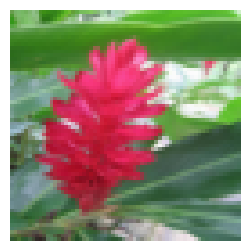

In [10]:
# checking the custom dataset & visualization

img, emb, label, name = train_dataset[0]
print(img.shape, emb.shape, label, name)
print(type(img), type(emb), type(label), type(name))
print(img.dtype, emb.dtype)

plt.figure(figsize=(3, 3))
plt.imshow(img.permute(1, 2, 0))
plt.axis('off')
plt.show()

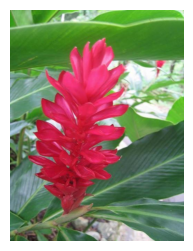

In [11]:
# original image

img = Image.open(f"{flowers102}/image_06814.jpg")
plt.figure(figsize=(3, 3))
plt.imshow(img)
plt.axis('off')
plt.show()

### Source Encoder - Feature Extraction  

This **Source Encoder** extracts meaningful **visual representations** from **64x64** RGB images and maps them to a **latent space** of size **256**.  

### Architecture:
- **6 Convolutional Layers** with increasing channels (3 → 512), reducing spatial dimensions via **stride-2**.
- **Batch Normalization** stabilizes training and **LeakyReLU** provides better gradient flow.
- **Final Linear Layer** flattens the feature map into a **256-dimensional latent vector**.

### Why this model?
- A **deep** yet **lightweight** encoder for rich feature extraction.
- Stride-based downsampling avoids information loss from max-pooling.
- Latent space of **256** balances dimensionality reduction with information preservation.


In [18]:
class SourceEncoder(nn.Module):
    def __init__(self, latent_dim: int = 256):
        super(SourceEncoder, self).__init__()

        torch.manual_seed(2022482)

        self.encoder = nn.Sequential(
            nn.Conv2d(3, 32, 3, stride=2, padding=1),  # [bs, 3, 64, 64] -> [bs, 32, 32, 32]
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.1),

            nn.Conv2d(32, 64, 3, stride=2, padding=1),  # [bs, 32, 32, 32] -> [bs, 64, 16, 16]
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.1),

            nn.Conv2d(64, 128, 3, stride=2, padding=1),  # [bs, 64, 16, 16] -> [bs, 128, 8, 8]
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.1),

            nn.Conv2d(128, 256, 3, stride=2, padding=1),  # [bs, 128, 8, 8] -> [bs, 256, 4, 4]
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.1),

            nn.Conv2d(256, 512, 3, stride=2, padding=1),  # [bs, 256, 4, 4] -> [bs, 512, 2, 2]
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.1),

            nn.Conv2d(512, 512, 3, stride=2, padding=1),  # [bs, 512, 2, 2] -> [bs, 512, 1, 1]
            nn.LeakyReLU(0.1)
        )

        self.flatten = nn.Sequential(
            nn.Linear(512 * 1 * 1, latent_dim),  # Flatten [bs, 512, 1, 1] -> [bs, latent_dim]
            nn.LeakyReLU(0.1)
        )

        # Print number of parameters
        num_params = sum(p.numel() for p in self.parameters() if p.requires_grad)
        print(f"SourceEncoder has {num_params} trainable parameters.")

    def forward(self, x):
        x = self.encoder(x)
        x = x.view(x.shape[0], -1)  # Flatten
        x = self.flatten(x)
        return x

# Initialize encoder
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
encoder = SourceEncoder(latent_dim=256).to(device)

# Test forward pass
input_tensor = torch.randn(1, 3, 64, 64).to(device)
output = encoder(input_tensor)
print(output.shape)  # Expected: [1, 256]

# Encoder Summary
summary(encoder, input_size=(3, 64, 64))


SourceEncoder has 4061696 trainable parameters.
torch.Size([1, 256])
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 32, 32, 32]             896
       BatchNorm2d-2           [-1, 32, 32, 32]              64
         LeakyReLU-3           [-1, 32, 32, 32]               0
            Conv2d-4           [-1, 64, 16, 16]          18,496
       BatchNorm2d-5           [-1, 64, 16, 16]             128
         LeakyReLU-6           [-1, 64, 16, 16]               0
            Conv2d-7            [-1, 128, 8, 8]          73,856
       BatchNorm2d-8            [-1, 128, 8, 8]             256
         LeakyReLU-9            [-1, 128, 8, 8]               0
           Conv2d-10            [-1, 256, 4, 4]         295,168
      BatchNorm2d-11            [-1, 256, 4, 4]             512
        LeakyReLU-12            [-1, 256, 4, 4]               0
           Conv2d-13            [-

### Model Summary (Source Encoder)

- **Total Parameters:** 4.06M  
- **Trainable Parameters:** 4.06M  
- **Model Size:** ~17MB  

### Target Generator Architecture

The **Generator** takes a **256-dimensional latent vector** and a **1024-dimensional text embedding** as input.  
It projects the combined input into a **spatial feature map (2x2x256)**, then **upsamples** through transposed convolutions, generating a **[bs, 3, 64, 64] RGB image**.

#### **Why this architecture?**
- Uses **latent and text embedding fusion** for conditioned generation.
- **Progressive upsampling** ensures smooth feature learning.
- **Batch Normalization & Leaky ReLU** aid stable training.
- **Tanh activation** normalizes the output between [-1, 1] for image representation.

---


In [20]:
class Generator(nn.Module):
    def __init__(self, latent_dim=256, text_dim=1024, out_channels=3):
        super(Generator, self).__init__()

        torch.manual_seed(2022482)

        # Project concatenated latent + text embedding to a spatial feature map
        self.projection = nn.Sequential(
            nn.Linear(latent_dim + text_dim, 256 * 2 * 2),  # Project to [bs, 1024] -> [bs, 1024]
            nn.LeakyReLU(0.1)
        )

        # Transposed convolutional layers to upsample the feature map
        self.generator = nn.Sequential(
            nn.ConvTranspose2d(256, 128, 4, stride=2, padding=1),  # [bs, 256, 2, 2] -> [bs, 128, 4, 4]
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.1),

            nn.ConvTranspose2d(128, 64, 4, stride=2, padding=1),  # [bs, 128, 4, 4] -> [bs, 64, 8, 8]
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.1),

            nn.ConvTranspose2d(64, 32, 4, stride=2, padding=1),  # [bs, 64, 8, 8] -> [bs, 32, 16, 16]
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.1),

            nn.ConvTranspose2d(32, 16, 4, stride=2, padding=1),  # [bs, 32, 16, 16] -> [bs, 16, 32, 32]
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.1),

            nn.ConvTranspose2d(16, out_channels, 4, stride=2, padding=1),  # [bs, 16, 32, 32] -> [bs, 3, 64, 64]
            nn.Tanh()  # Output in range [-1, 1] (normalized image)
        )

        # Print number of parameters
        num_params = sum(p.numel() for p in self.parameters() if p.requires_grad)
        print(f"TargetGenerator has {num_params} trainable parameters.")

    def forward(self, latent_vector, text_embedding):
        x = torch.cat((latent_vector, text_embedding), dim=1)  # Concatenate latent + text embeddings
        x = self.projection(x)
        x = x.view(x.shape[0], 256, 2, 2)  # Reshape to [bs, 256, 2, 2]
        x = self.generator(x)
        return x

# Initialize generator
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
generator = Generator(latent_dim=256, text_dim=1024).to(device)

# Test forward pass
latent_vector = torch.randn(1, 256).to(device)
text_embedding = torch.randn(1, 1024).to(device)
output_image = generator(latent_vector, text_embedding)
print(output_image.shape)  # Expected: [1, 3, 64, 64]

summary(generator, [(256,), (1024,)])


TargetGenerator has 2009555 trainable parameters.
torch.Size([1, 3, 64, 64])
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Linear-1                 [-1, 1024]       1,311,744
         LeakyReLU-2                 [-1, 1024]               0
   ConvTranspose2d-3            [-1, 128, 4, 4]         524,416
       BatchNorm2d-4            [-1, 128, 4, 4]             256
         LeakyReLU-5            [-1, 128, 4, 4]               0
   ConvTranspose2d-6             [-1, 64, 8, 8]         131,136
       BatchNorm2d-7             [-1, 64, 8, 8]             128
         LeakyReLU-8             [-1, 64, 8, 8]               0
   ConvTranspose2d-9           [-1, 32, 16, 16]          32,800
      BatchNorm2d-10           [-1, 32, 16, 16]              64
        LeakyReLU-11           [-1, 32, 16, 16]               0
  ConvTranspose2d-12           [-1, 16, 32, 32]           8,208
      BatchNorm2d-13      

### Model Summary (Target Generator)

- **Total Parameters:** 2.01M  
- **Trainable Parameters:** 2.01M  
- **Model Size:** ~9.57MB  


### Discriminator Architecture

The discriminator is a **CNN-based binary classifier** that distinguishes between real and generated images. It processes a **64×64 RGB image** through a series of convolutional layers and outputs a **single scalar value** per image, representing its realism.

#### **Architecture:**
- **Conv Block 1**: (3 → 32) Feature extraction with downsampling (64x64 → 32x32).
- **Conv Block 2**: (32 → 64) Deeper feature representation (32x32 → 16x16).
- **Conv Block 3**: (64 → 128) Enhanced feature extraction (16x16 → 8x8).
- **Conv Block 4**: (128 → 256) Further downsampling (8x8 → 4x4).
- **Conv Block 5**: (256 → 512) Deepest feature extraction (4x4 → 2x2).
- **Final Conv**: (512 → 1) Outputting a **single score** for real/fake classification.

#### **Design Choices:**
- **LeakyReLU (0.1)**: Helps prevent vanishing gradients.
- **BatchNorm**: Stabilizes training and improves convergence.
- **Progressive Downsampling**: Reduces resolution while increasing feature depth.
- **Final 1×1 Output**: Single prediction score for binary classification.

This architecture ensures efficient feature extraction and helps the discriminator effectively learn to distinguish real images from generated ones.


In [21]:
import torch
import torch.nn as nn
from torchsummary import summary

class Discriminator(nn.Module):
    def __init__(self, in_channels=3):
        super(Discriminator, self).__init__()

        torch.manual_seed(2022482) 

        self.discriminator = nn.Sequential(
            nn.Conv2d(in_channels, 32, 4, stride=2, padding=1),  # [bs, 3, 64, 64] -> [bs, 32, 32, 32]
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.1),

            nn.Conv2d(32, 64, 4, stride=2, padding=1),  # [bs, 32, 32, 32] -> [bs, 64, 16, 16]
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.1),

            nn.Conv2d(64, 128, 4, stride=2, padding=1),  # [bs, 64, 16, 16] -> [bs, 128, 8, 8]
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.1),

            nn.Conv2d(128, 256, 4, stride=2, padding=1),  # [bs, 128, 8, 8] -> [bs, 256, 4, 4]
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.1),

            nn.Conv2d(256, 512, 4, stride=2, padding=1),  # [bs, 256, 4, 4] -> [bs, 512, 2, 2]
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.1),

            nn.Conv2d(512, 1, 2, stride=1),  # [bs, 512, 2, 2] -> [bs, 1, 1, 1]
        )

        # Print number of trainable parameters
        num_params = sum(p.numel() for p in self.parameters() if p.requires_grad)
        print(f"Discriminator has {num_params} trainable parameters.")

    def forward(self, x):
        return self.discriminator(x).view(-1, 1)  # Output shape: [bs, 1]

# Initialize discriminator
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
discriminator = Discriminator().to(device)

# Test forward pass
input_image = torch.randn(1, 3, 64, 64).to(device)
output = discriminator(input_image)
print(output.shape)  # Expected: [1, 1]
print(output)  # Check output values

summary(discriminator, input_size=(3, 64, 64))


Discriminator has 2791841 trainable parameters.
torch.Size([1, 1])
tensor([[0.6191]], device='cuda:0', grad_fn=<ViewBackward0>)
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 32, 32, 32]           1,568
       BatchNorm2d-2           [-1, 32, 32, 32]              64
         LeakyReLU-3           [-1, 32, 32, 32]               0
            Conv2d-4           [-1, 64, 16, 16]          32,832
       BatchNorm2d-5           [-1, 64, 16, 16]             128
         LeakyReLU-6           [-1, 64, 16, 16]               0
            Conv2d-7            [-1, 128, 8, 8]         131,200
       BatchNorm2d-8            [-1, 128, 8, 8]             256
         LeakyReLU-9            [-1, 128, 8, 8]               0
           Conv2d-10            [-1, 256, 4, 4]         524,544
      BatchNorm2d-11            [-1, 256, 4, 4]             512
        LeakyReLU-12            [-1, 25

### Model Summary (Discriminator)

- **Total Parameters:** 2.79M  
- **Trainable Parameters:** 2.79M  
- **Model Size:** ~12.15MB  


## TRAINING SECTION

## Training Paradigm for Generative Adversarial Text-to-Image Synthesis

### 1. **Overview**
This model follows the Wasserstein GAN (WGAN) training approach to generate images conditioned on textual descriptions.  
- **Generator:** Converts text embeddings and latent features into images.  
- **Discriminator:** Differentiates between real and generated images.  
- **Source Encoder:** Extracts feature representations from real images.  

### 2. **Reasoning Behind Key Design Choices**
- **WGAN Loss (No Sigmoid, No BCE Loss)**  
  - Avoids vanishing gradients in standard GANs.  
  - Uses Wasserstein loss to improve training stability.  

- **Weight Clipping (`WEIGHT_CLIP=0.01`)**  
  - Ensures Lipschitz continuity for the discriminator.  
  - Prevents gradient explosion or collapse.  

- **Critic Training (Discriminator Updated `N_CRITIC=5` times per Generator update)**  
  - Ensures the discriminator is well-trained before updating the generator.  
  - Prevents the generator from overpowering an undertrained discriminator.  

- **Optimizers: RMSprop (`optim.RMSprop`)**  
  - Suggested for WGAN to maintain stability without momentum.  

### 3. **Training Steps**
1. **Discriminator Training (`N_CRITIC` Updates per Generator Update)**
   - Receives both real and generated (fake) images.
   - Computes Wasserstein loss (`real - fake` score difference).
   - Updates weights using RMSprop.
   - Applies weight clipping to maintain stability.

2. **Generator Training (Every `N_CRITIC` Steps)**
   - Generates fake images using the generator.
   - Evaluates quality using the discriminator.
   - Computes loss and updates generator parameters.

3. **Visualization & Model Evaluation**
   - Every 5 epochs, generates 25 images (5 per test class) for qualitative evaluation.
   - Displays results in a 5×5 grid.

### 4. **Why This Works**
- **WGAN ensures proper convergence** by using Wasserstein loss.  
- **Text embeddings improve image relevance** by conditioning on descriptions.  
- **Multi-GPU training speeds up** large dataset processing.  
- **Periodic visualization allows tracking** of image generation quality.  

### 5. **Final Notes**
- This approach follows a strict **adversarial training** paradigm.  
- The generator is only updated after ensuring the discriminator is adequately trained.  
- Results can be further improved with **Gradient Penalty (WGAN-GP)** instead of weight clipping, but not opted as taking 6 minutes per epoch, not under time constraint given in assignment.



SourceEncoder has 4061696 trainable parameters.
TargetGenerator has 2009555 trainable parameters.
Discriminator has 2791841 trainable parameters.


  0%|          | 0/484 [00:00<?, ?it/s]

100%|██████████| 484/484 [00:15<00:00, 30.86it/s]


Epoch [0/100] D Loss: -0.3813 G Loss: 0.1823


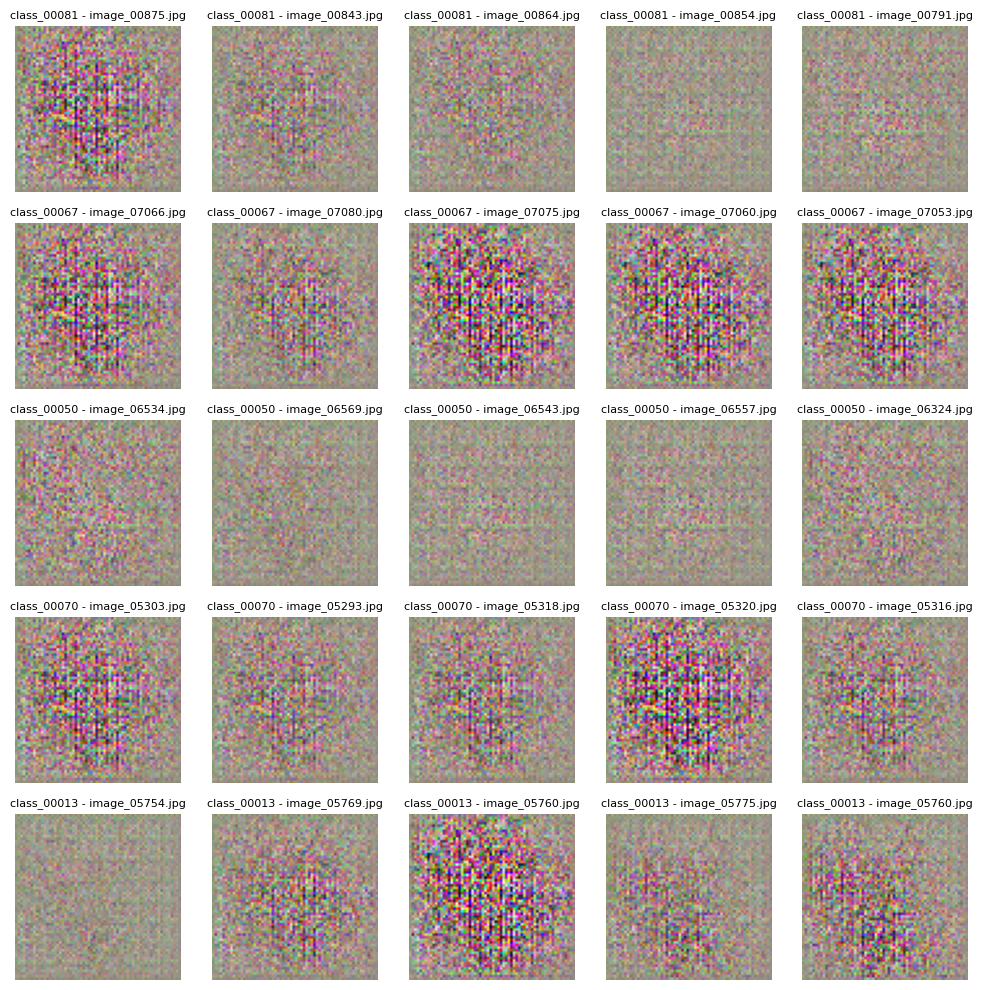

100%|██████████| 484/484 [00:15<00:00, 31.25it/s]


Epoch [1/100] D Loss: -0.3815 G Loss: 0.1824


100%|██████████| 484/484 [00:15<00:00, 31.30it/s]


Epoch [2/100] D Loss: -0.3817 G Loss: 0.1824


100%|██████████| 484/484 [00:15<00:00, 31.40it/s]


Epoch [3/100] D Loss: -0.3816 G Loss: 0.1824


100%|██████████| 484/484 [00:15<00:00, 31.39it/s]


Epoch [4/100] D Loss: -0.2175 G Loss: -0.1913


100%|██████████| 484/484 [00:15<00:00, 31.36it/s]


Epoch [5/100] D Loss: -0.3811 G Loss: 0.1822


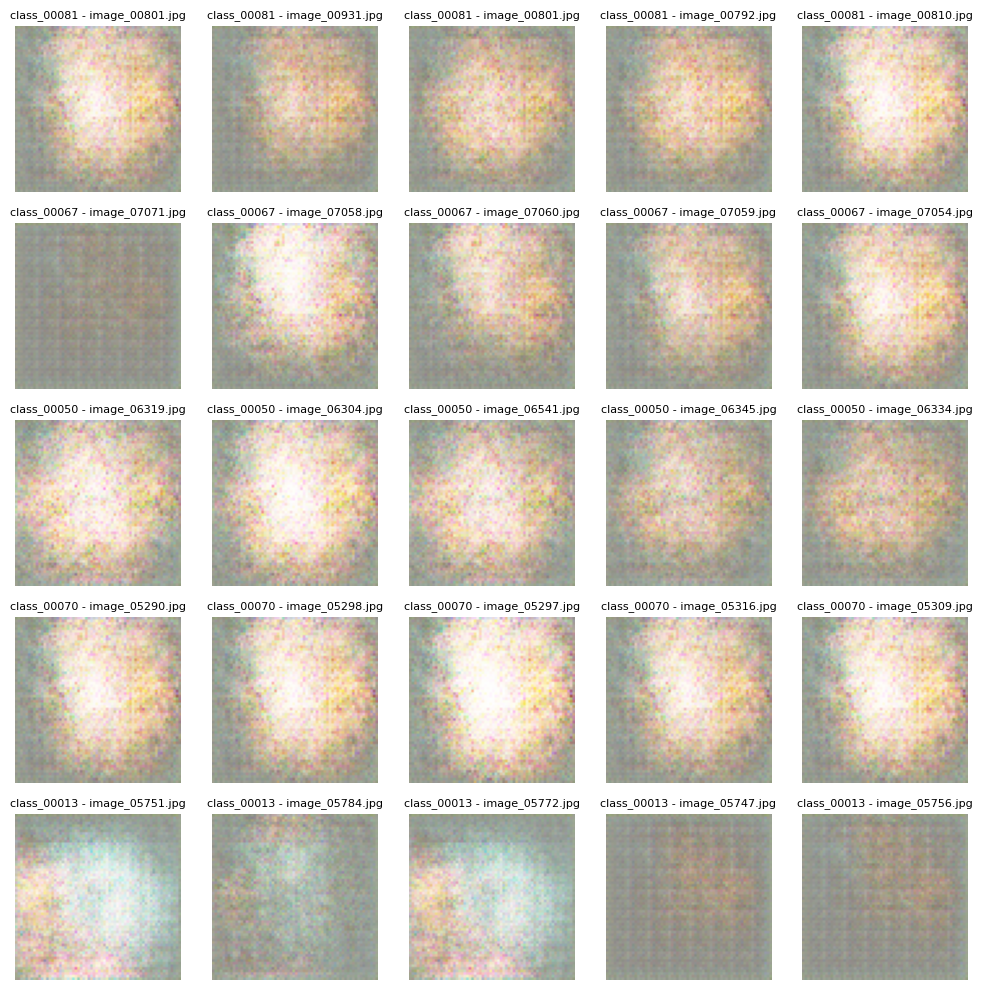

100%|██████████| 484/484 [00:15<00:00, 31.09it/s]


Epoch [6/100] D Loss: -0.3808 G Loss: 0.1821


100%|██████████| 484/484 [00:15<00:00, 31.11it/s]


Epoch [7/100] D Loss: -0.3809 G Loss: 0.1821


100%|██████████| 484/484 [00:15<00:00, 30.97it/s]


Epoch [8/100] D Loss: -0.3707 G Loss: 0.1784


100%|██████████| 484/484 [00:15<00:00, 31.09it/s]


Epoch [9/100] D Loss: -0.3795 G Loss: 0.1814


100%|██████████| 484/484 [00:15<00:00, 31.00it/s]


Epoch [10/100] D Loss: -0.3792 G Loss: 0.1814


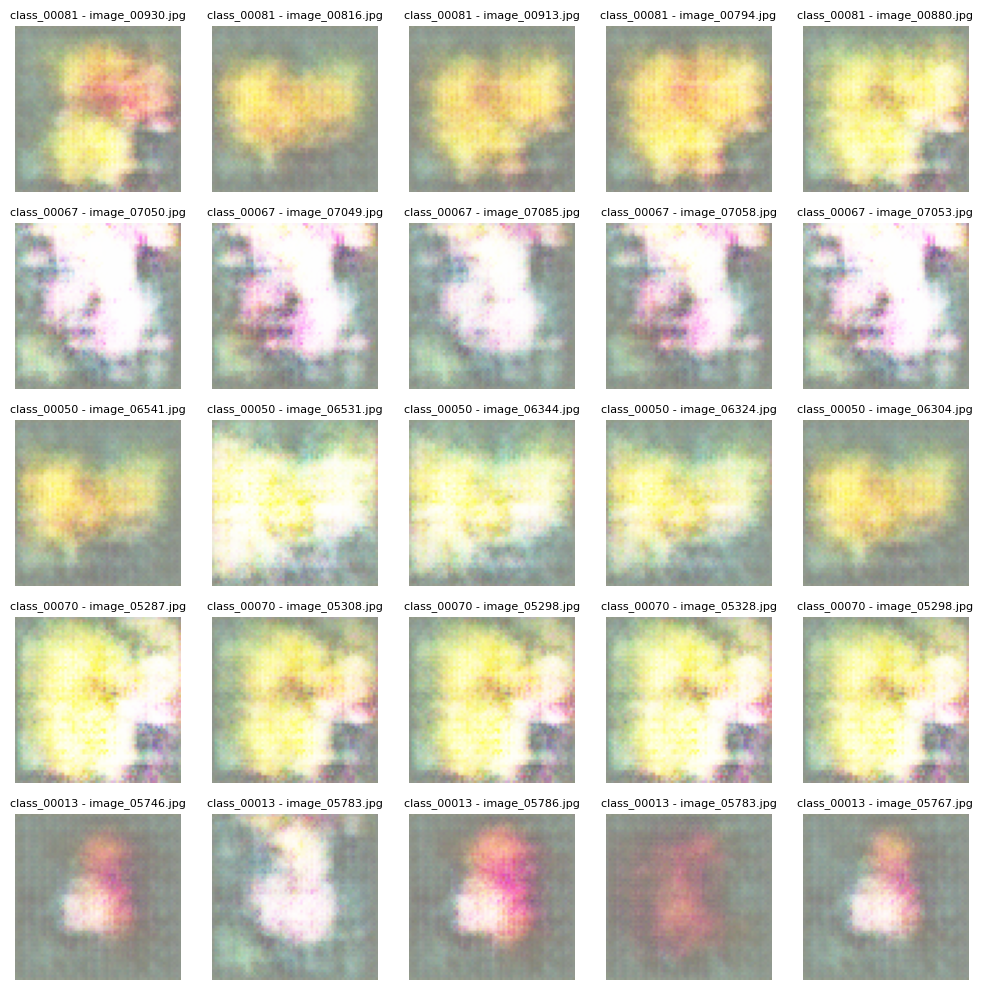

100%|██████████| 484/484 [00:15<00:00, 30.91it/s]


Epoch [11/100] D Loss: -0.3802 G Loss: 0.1817


100%|██████████| 484/484 [00:15<00:00, 30.90it/s]


Epoch [12/100] D Loss: -0.3790 G Loss: 0.1811


100%|██████████| 484/484 [00:15<00:00, 30.87it/s]


Epoch [13/100] D Loss: -0.3758 G Loss: 0.1794


100%|██████████| 484/484 [00:15<00:00, 30.88it/s]


Epoch [14/100] D Loss: -0.3797 G Loss: 0.1815


100%|██████████| 484/484 [00:16<00:00, 28.79it/s]


Epoch [15/100] D Loss: -0.3786 G Loss: 0.1807


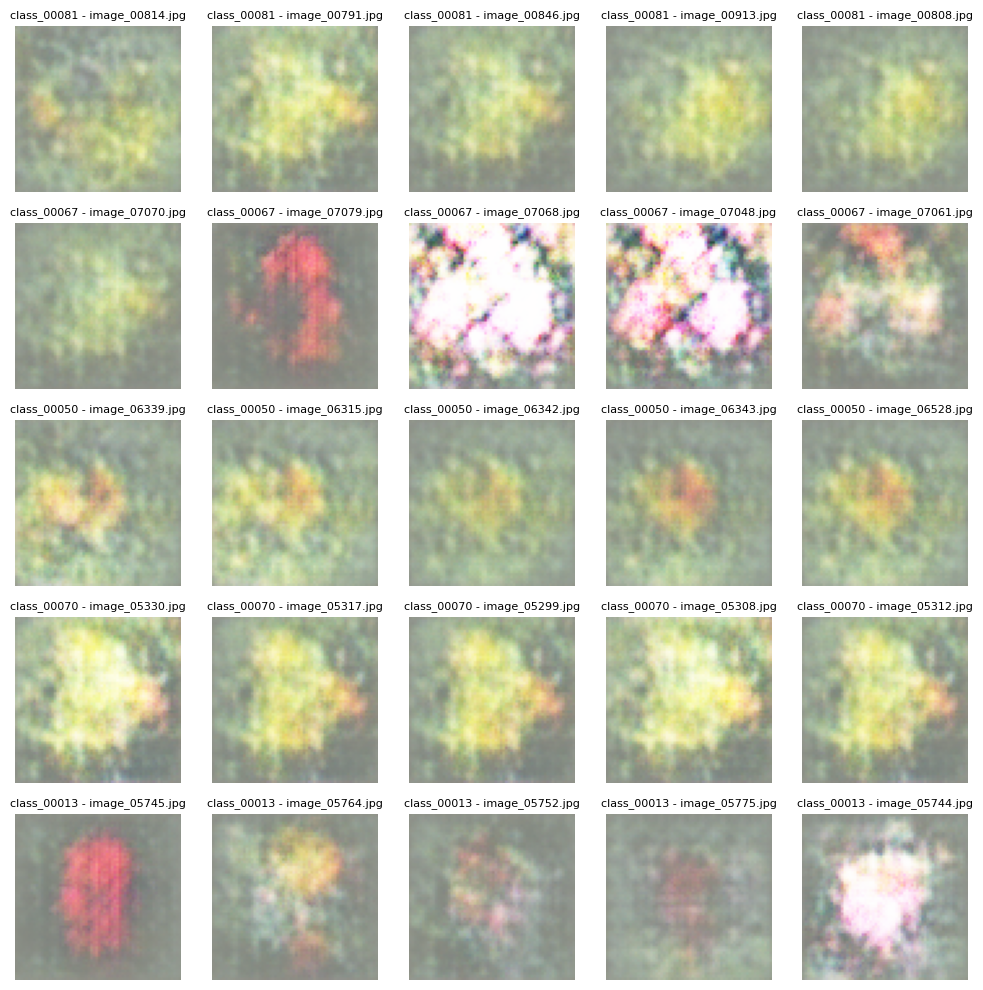

100%|██████████| 484/484 [00:16<00:00, 29.70it/s]


Epoch [16/100] D Loss: -0.3787 G Loss: 0.1810


100%|██████████| 484/484 [00:15<00:00, 32.20it/s]


Epoch [17/100] D Loss: -0.3739 G Loss: 0.1791


100%|██████████| 484/484 [00:14<00:00, 32.42it/s]


Epoch [18/100] D Loss: -0.3791 G Loss: 0.1810


100%|██████████| 484/484 [00:15<00:00, 32.03it/s]


Epoch [19/100] D Loss: -0.3318 G Loss: 0.1614


100%|██████████| 484/484 [00:15<00:00, 32.04it/s]


Epoch [20/100] D Loss: -0.3778 G Loss: 0.1803


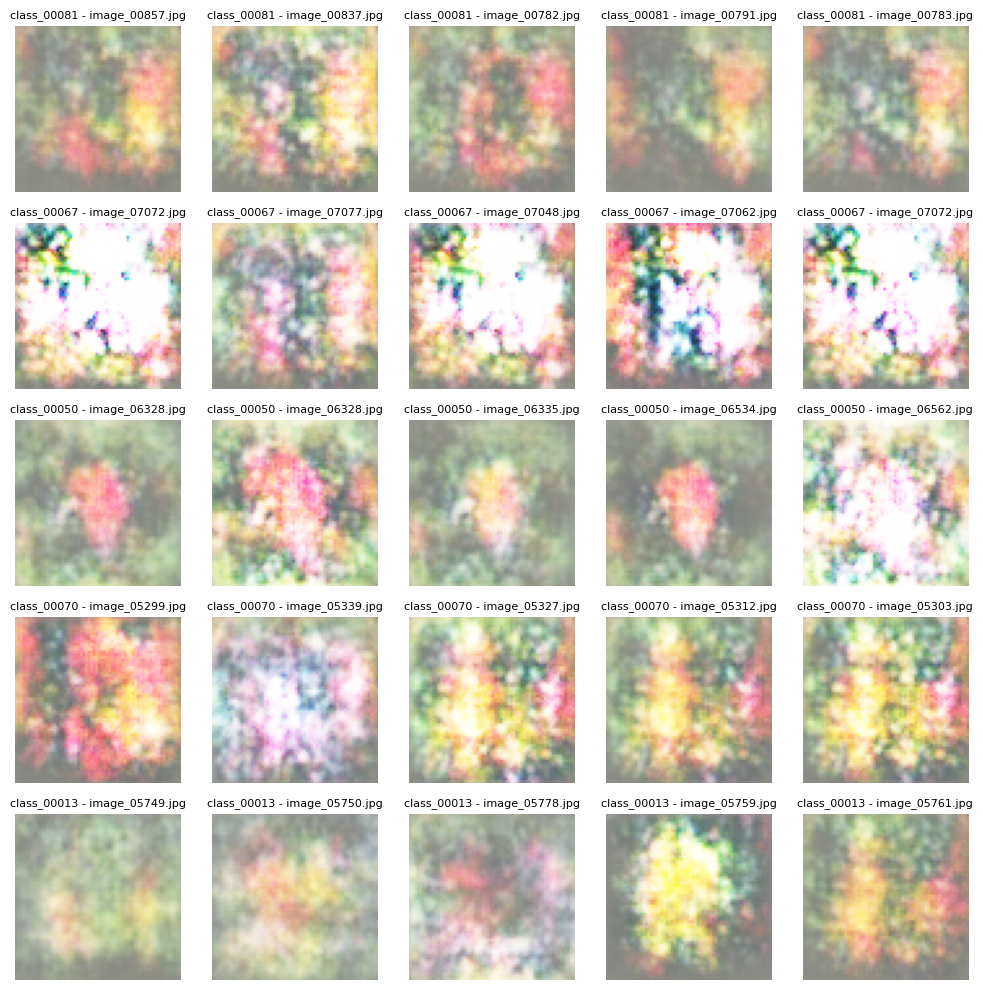

100%|██████████| 484/484 [00:15<00:00, 32.21it/s]


Epoch [21/100] D Loss: -0.3779 G Loss: 0.1805


100%|██████████| 484/484 [00:14<00:00, 32.34it/s]


Epoch [22/100] D Loss: -0.3760 G Loss: 0.1798


100%|██████████| 484/484 [00:15<00:00, 32.04it/s]


Epoch [23/100] D Loss: -0.3774 G Loss: 0.1804


100%|██████████| 484/484 [00:15<00:00, 32.08it/s]


Epoch [24/100] D Loss: -0.3020 G Loss: 0.1723


100%|██████████| 484/484 [00:15<00:00, 32.17it/s]


Epoch [25/100] D Loss: -0.3740 G Loss: 0.1802


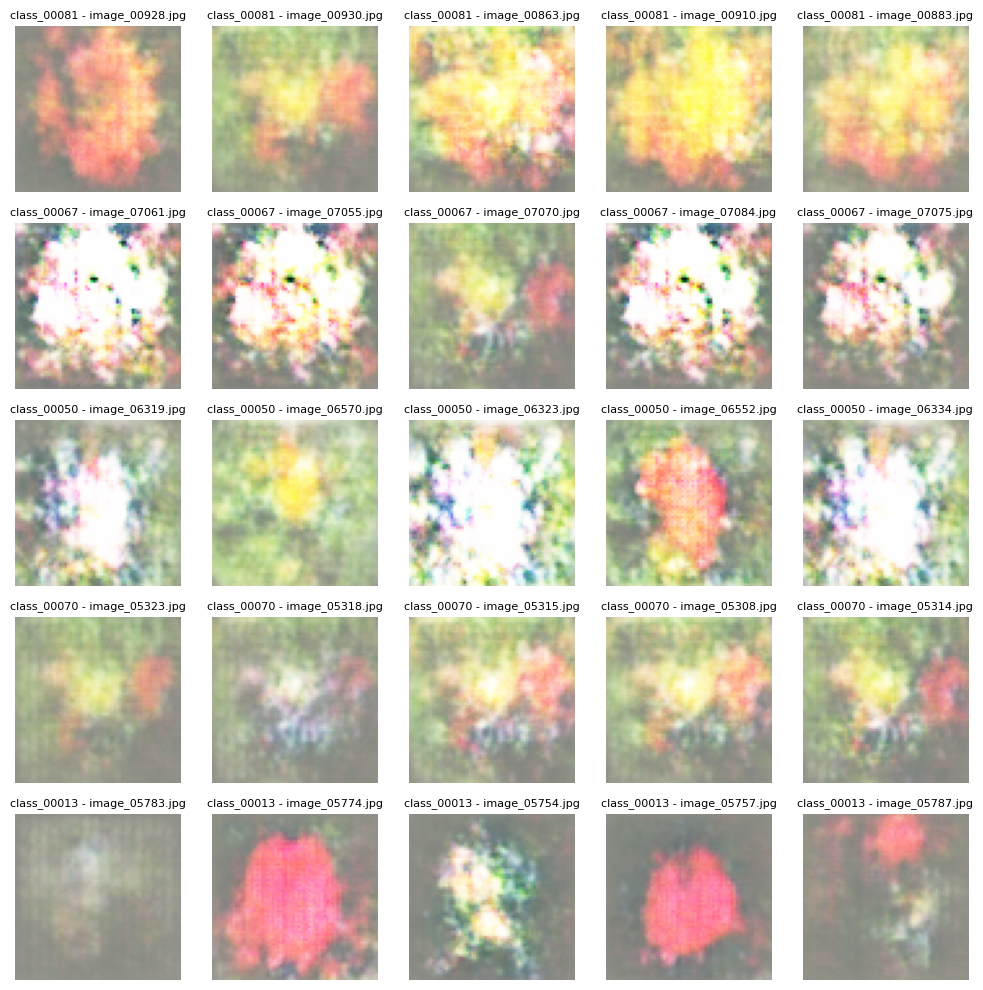

100%|██████████| 484/484 [00:15<00:00, 32.12it/s]


Epoch [26/100] D Loss: -0.3779 G Loss: 0.1805


100%|██████████| 484/484 [00:15<00:00, 31.91it/s]


Epoch [27/100] D Loss: -0.3771 G Loss: 0.1800


100%|██████████| 484/484 [00:14<00:00, 32.46it/s]


Epoch [28/100] D Loss: -0.3774 G Loss: 0.1808


100%|██████████| 484/484 [00:15<00:00, 31.97it/s]


Epoch [29/100] D Loss: -0.3784 G Loss: 0.1807


100%|██████████| 484/484 [00:15<00:00, 32.07it/s]


Epoch [30/100] D Loss: -0.3766 G Loss: 0.1800


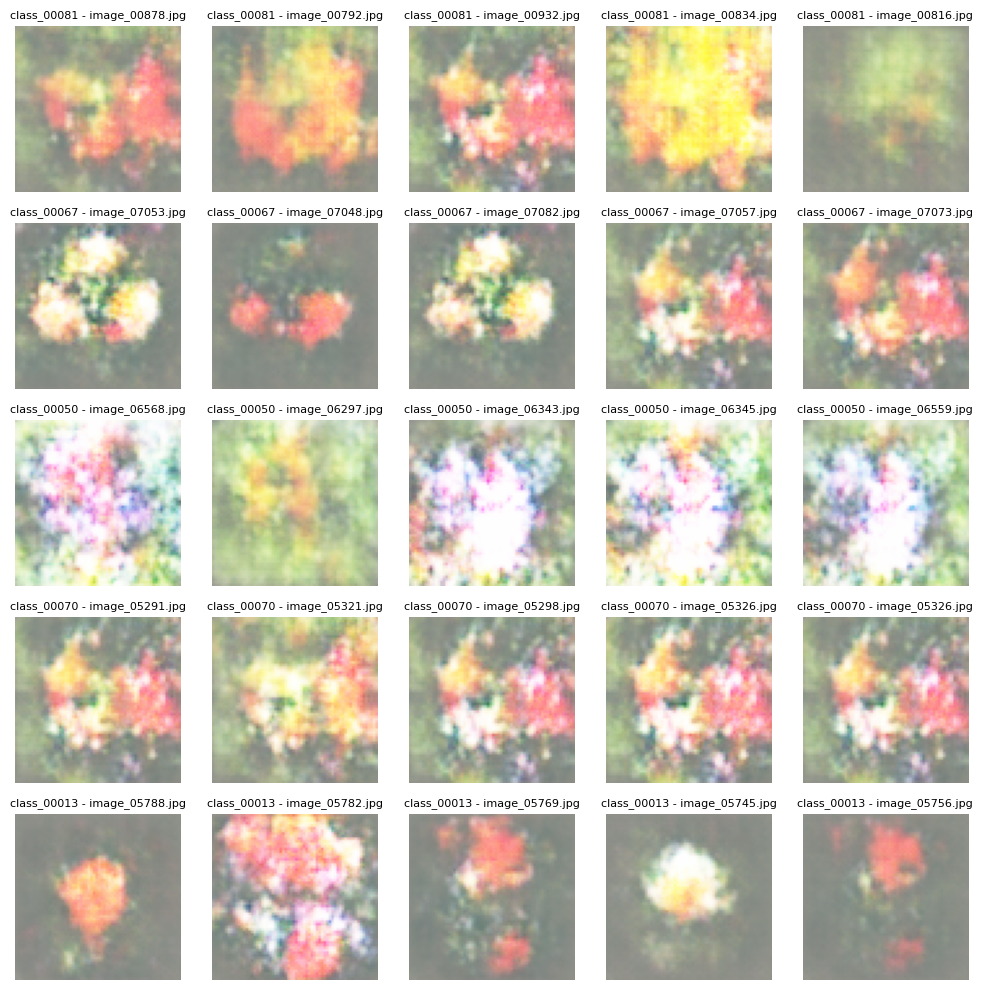

100%|██████████| 484/484 [00:15<00:00, 32.15it/s]


Epoch [31/100] D Loss: -0.3769 G Loss: 0.1801


100%|██████████| 484/484 [00:15<00:00, 32.21it/s]


Epoch [32/100] D Loss: -0.3768 G Loss: 0.1803


100%|██████████| 484/484 [00:15<00:00, 32.09it/s]


Epoch [33/100] D Loss: -0.3750 G Loss: 0.1799


100%|██████████| 484/484 [00:15<00:00, 32.03it/s]


Epoch [34/100] D Loss: -0.3756 G Loss: 0.1796


100%|██████████| 484/484 [00:15<00:00, 32.15it/s]


Epoch [35/100] D Loss: -0.3778 G Loss: 0.1806


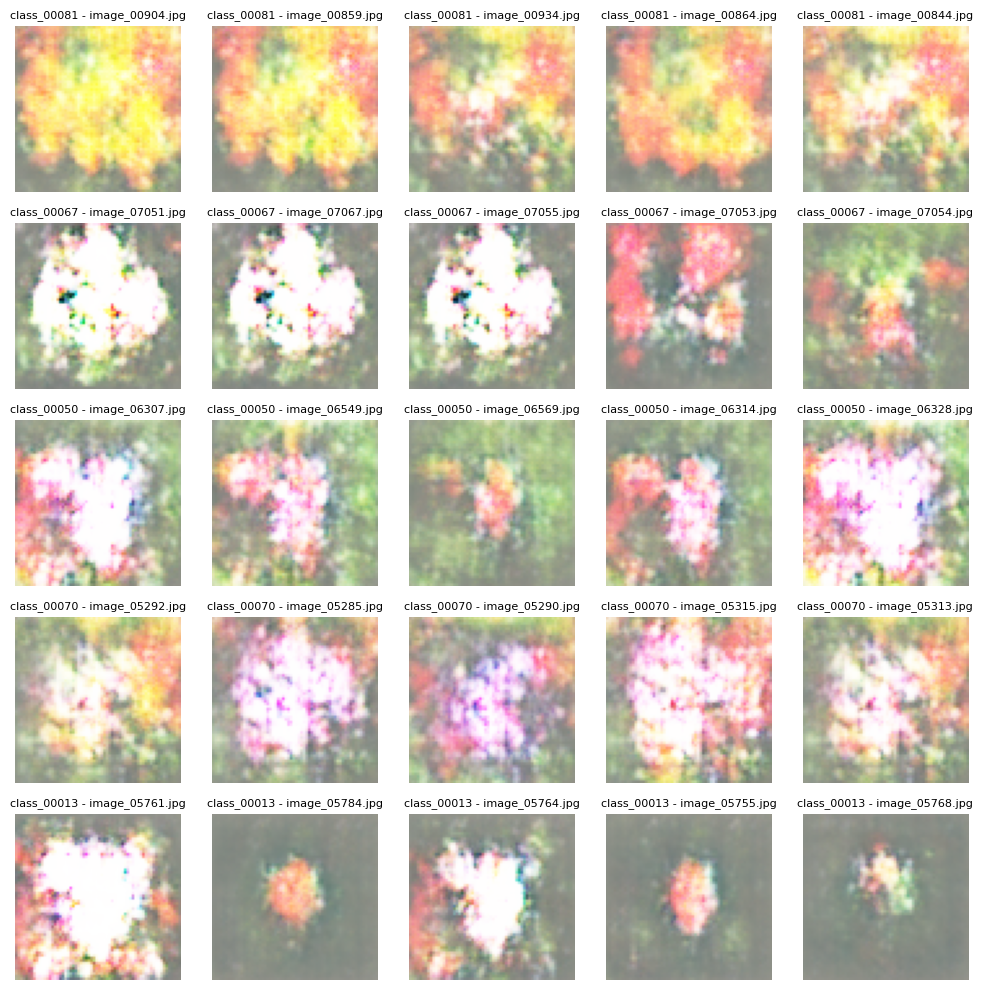

100%|██████████| 484/484 [00:14<00:00, 32.27it/s]


Epoch [36/100] D Loss: -0.3771 G Loss: 0.1800


100%|██████████| 484/484 [00:15<00:00, 31.86it/s]


Epoch [37/100] D Loss: -0.3737 G Loss: 0.1784


100%|██████████| 484/484 [00:16<00:00, 30.09it/s]


Epoch [38/100] D Loss: -0.3753 G Loss: 0.1794


100%|██████████| 484/484 [00:15<00:00, 32.07it/s]


Epoch [39/100] D Loss: -0.2520 G Loss: 0.1603


100%|██████████| 484/484 [00:15<00:00, 31.86it/s]


Epoch [40/100] D Loss: -0.3704 G Loss: 0.1769


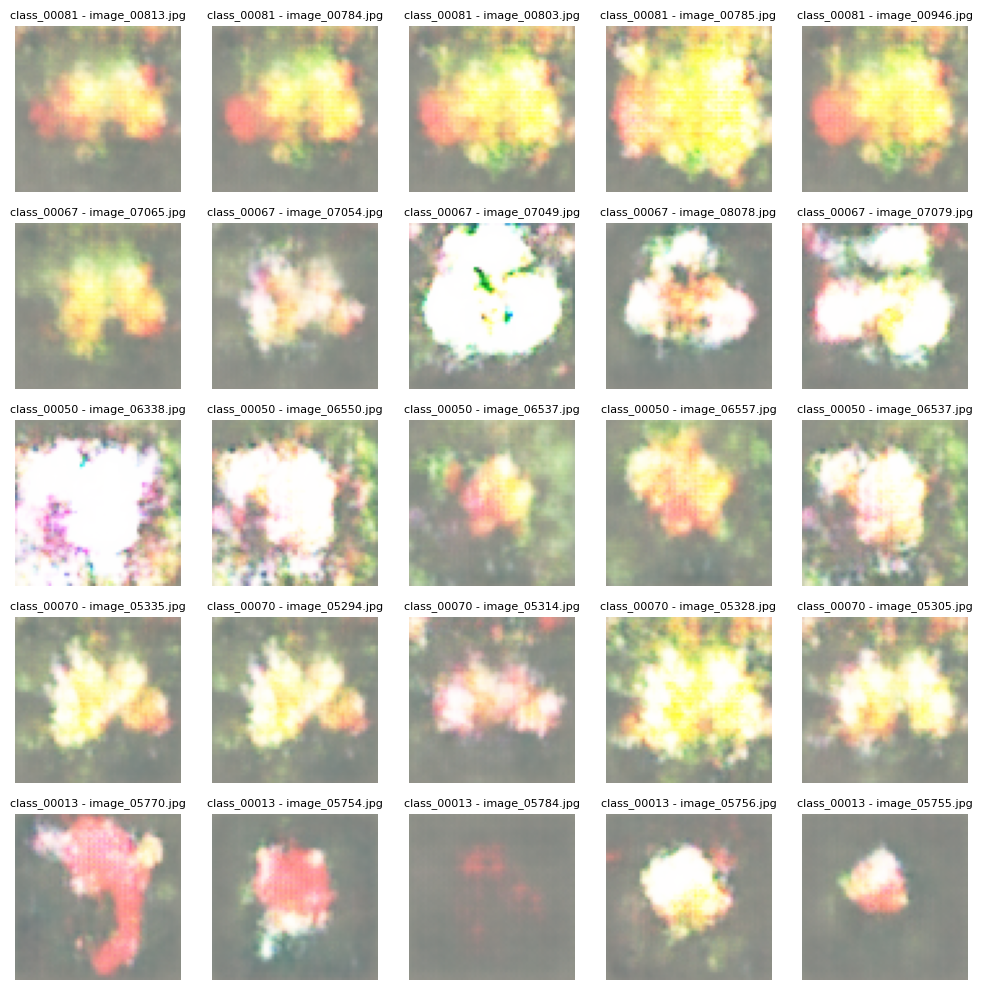

100%|██████████| 484/484 [00:15<00:00, 31.86it/s]


Epoch [41/100] D Loss: -0.3117 G Loss: 0.1684


100%|██████████| 484/484 [00:15<00:00, 31.93it/s]


Epoch [42/100] D Loss: -0.3772 G Loss: 0.1802


100%|██████████| 484/484 [00:15<00:00, 31.88it/s]


Epoch [43/100] D Loss: -0.3777 G Loss: 0.1808


100%|██████████| 484/484 [00:15<00:00, 32.05it/s]


Epoch [44/100] D Loss: -0.3723 G Loss: 0.1802


100%|██████████| 484/484 [00:15<00:00, 32.18it/s]


Epoch [45/100] D Loss: -0.3769 G Loss: 0.1798


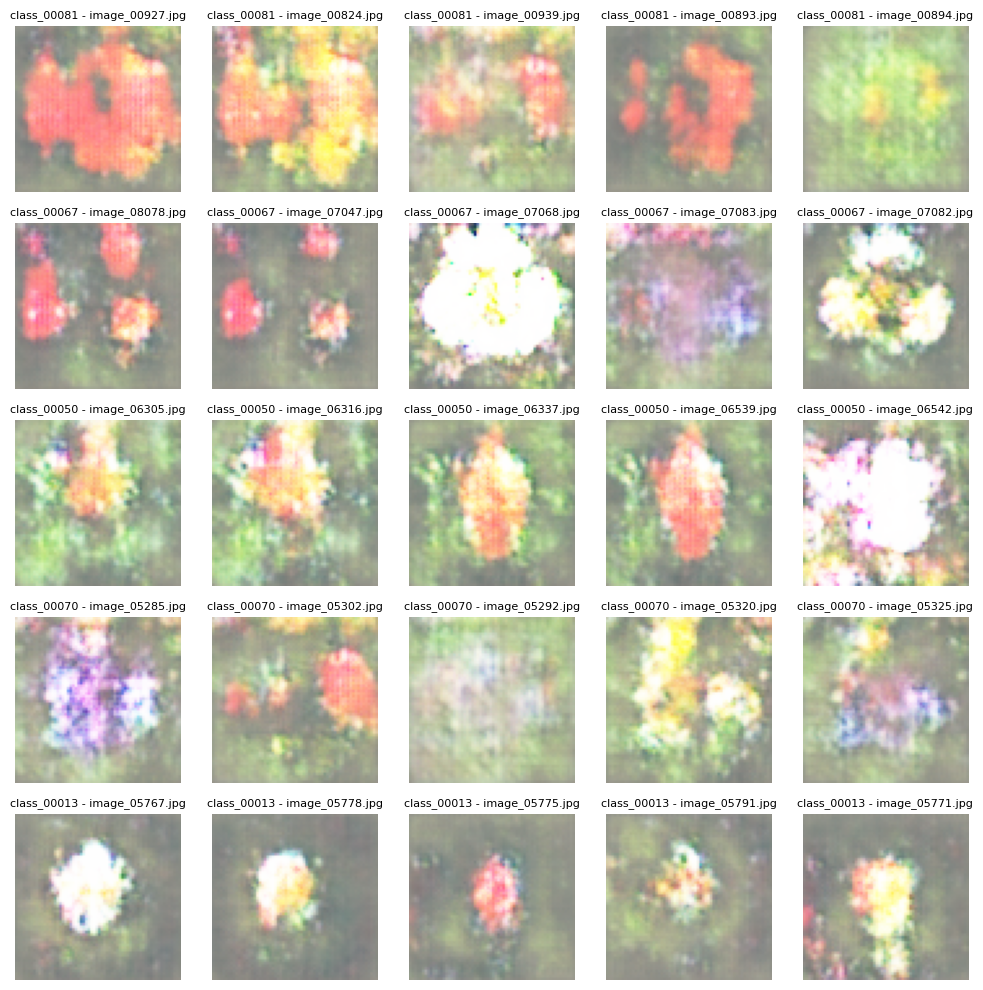

100%|██████████| 484/484 [00:14<00:00, 32.28it/s]


Epoch [46/100] D Loss: -0.3628 G Loss: 0.1754


100%|██████████| 484/484 [00:15<00:00, 32.18it/s]


Epoch [47/100] D Loss: -0.0777 G Loss: 0.1146


100%|██████████| 484/484 [00:15<00:00, 31.80it/s]


Epoch [48/100] D Loss: -0.3774 G Loss: 0.1802


100%|██████████| 484/484 [00:15<00:00, 31.78it/s]


Epoch [49/100] D Loss: -0.3753 G Loss: 0.1794


100%|██████████| 484/484 [00:15<00:00, 31.82it/s]


Epoch [50/100] D Loss: -0.3763 G Loss: 0.1805


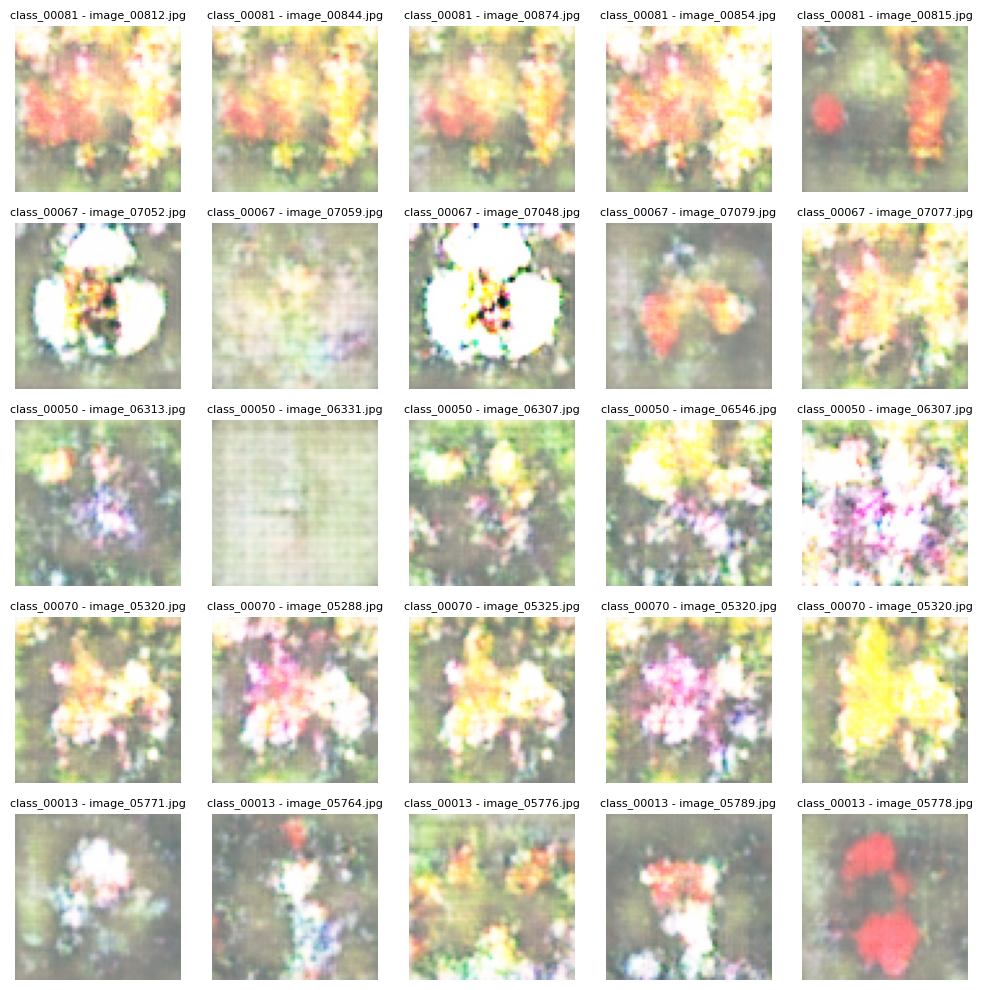

100%|██████████| 484/484 [00:15<00:00, 32.03it/s]


Epoch [51/100] D Loss: -0.3750 G Loss: 0.1798


100%|██████████| 484/484 [00:15<00:00, 32.03it/s]


Epoch [52/100] D Loss: -0.3757 G Loss: 0.1812


100%|██████████| 484/484 [00:15<00:00, 32.13it/s]


Epoch [53/100] D Loss: -0.3753 G Loss: 0.1801


100%|██████████| 484/484 [00:15<00:00, 32.13it/s]


Epoch [54/100] D Loss: -0.3758 G Loss: 0.1792


100%|██████████| 484/484 [00:15<00:00, 31.95it/s]


Epoch [55/100] D Loss: -0.3759 G Loss: 0.1796


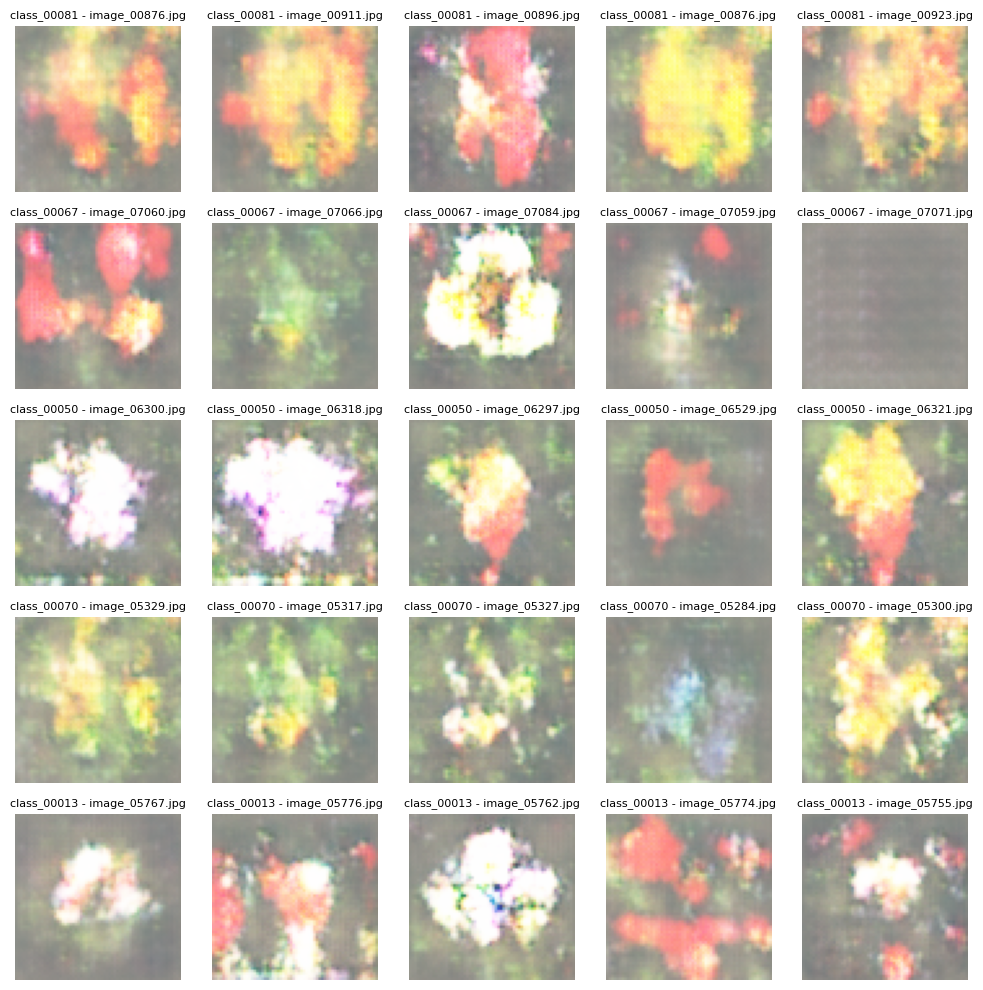

100%|██████████| 484/484 [00:15<00:00, 31.67it/s]


Epoch [56/100] D Loss: -0.3725 G Loss: 0.1785


100%|██████████| 484/484 [00:15<00:00, 32.15it/s]


Epoch [57/100] D Loss: -0.3779 G Loss: 0.1802


100%|██████████| 484/484 [00:15<00:00, 32.00it/s]


Epoch [58/100] D Loss: -0.3767 G Loss: 0.1801


100%|██████████| 484/484 [00:15<00:00, 32.19it/s]


Epoch [59/100] D Loss: -0.3763 G Loss: 0.1801


100%|██████████| 484/484 [00:15<00:00, 31.93it/s]


Epoch [60/100] D Loss: -0.3746 G Loss: 0.1788


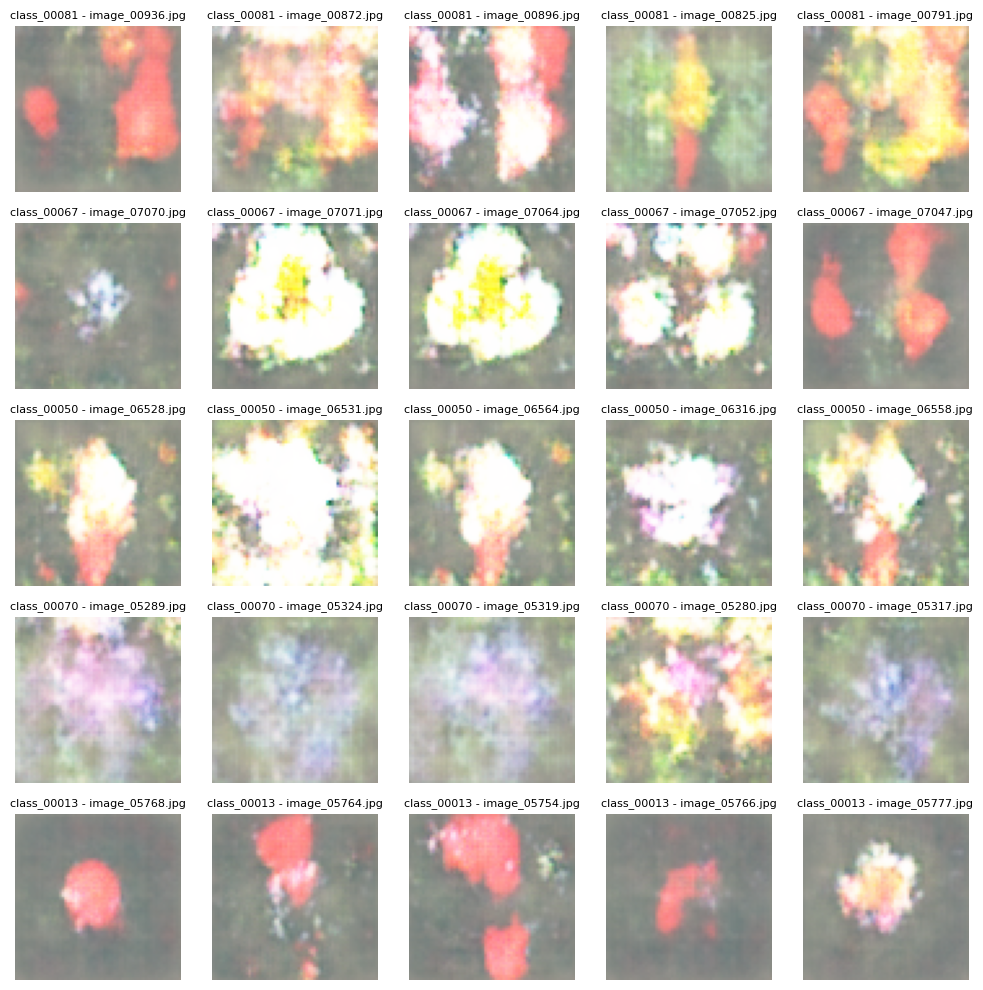

100%|██████████| 484/484 [00:15<00:00, 32.13it/s]


Epoch [61/100] D Loss: -0.3755 G Loss: 0.1791


100%|██████████| 484/484 [00:15<00:00, 31.72it/s]


Epoch [62/100] D Loss: -0.3772 G Loss: 0.1805


100%|██████████| 484/484 [00:15<00:00, 31.97it/s]


Epoch [63/100] D Loss: -0.0406 G Loss: 0.1509


100%|██████████| 484/484 [00:15<00:00, 32.13it/s]


Epoch [64/100] D Loss: -0.3757 G Loss: 0.1798


100%|██████████| 484/484 [00:15<00:00, 32.25it/s]


Epoch [65/100] D Loss: -0.3757 G Loss: 0.1798


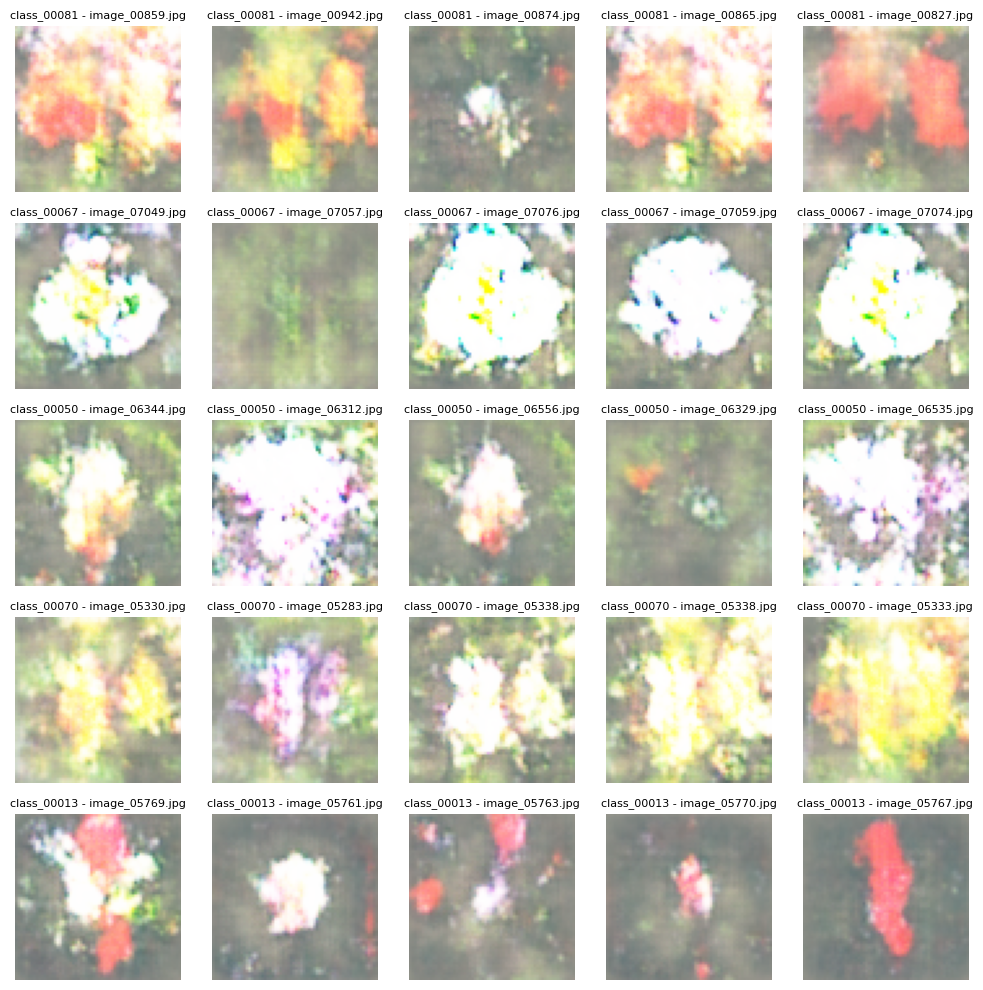

100%|██████████| 484/484 [00:15<00:00, 31.71it/s]


Epoch [66/100] D Loss: -0.3751 G Loss: 0.1791


100%|██████████| 484/484 [00:15<00:00, 31.89it/s]


Epoch [67/100] D Loss: -0.3724 G Loss: 0.1782


100%|██████████| 484/484 [00:15<00:00, 31.99it/s]


Epoch [68/100] D Loss: -0.3736 G Loss: 0.1787


100%|██████████| 484/484 [00:15<00:00, 31.84it/s]


Epoch [69/100] D Loss: -0.3705 G Loss: 0.1771


100%|██████████| 484/484 [00:15<00:00, 31.90it/s]


Epoch [70/100] D Loss: -0.3750 G Loss: 0.1790


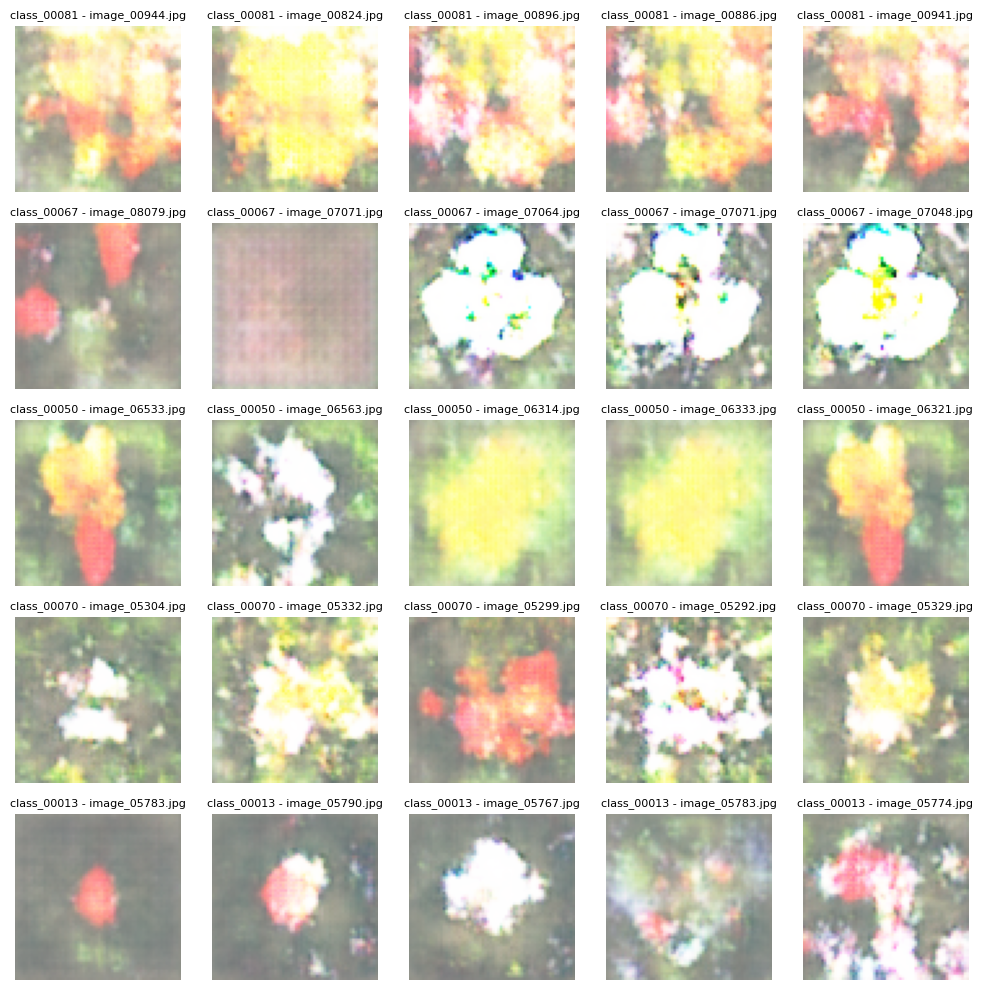

100%|██████████| 484/484 [00:14<00:00, 32.29it/s]


Epoch [71/100] D Loss: -0.2041 G Loss: 0.1349


100%|██████████| 484/484 [00:15<00:00, 32.18it/s]


Epoch [72/100] D Loss: -0.3722 G Loss: 0.1788


100%|██████████| 484/484 [00:15<00:00, 32.23it/s]


Epoch [73/100] D Loss: -0.3747 G Loss: 0.1790


100%|██████████| 484/484 [00:15<00:00, 31.89it/s]


Epoch [74/100] D Loss: -0.3742 G Loss: 0.1802


100%|██████████| 484/484 [00:15<00:00, 32.01it/s]


Epoch [75/100] D Loss: -0.3736 G Loss: 0.1793


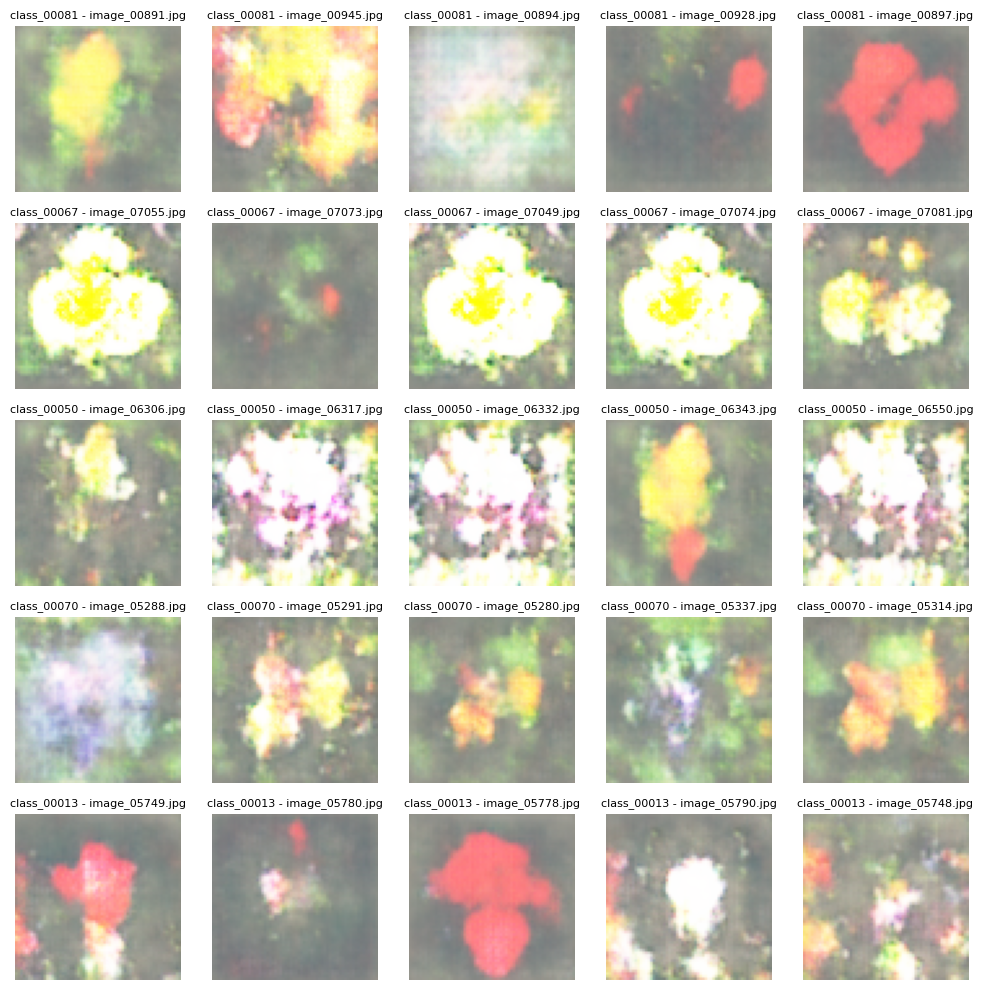

100%|██████████| 484/484 [00:15<00:00, 31.76it/s]


Epoch [76/100] D Loss: -0.3700 G Loss: 0.1773


100%|██████████| 484/484 [00:15<00:00, 31.97it/s]


Epoch [77/100] D Loss: -0.3724 G Loss: 0.1782


100%|██████████| 484/484 [00:15<00:00, 32.16it/s]


Epoch [78/100] D Loss: -0.3666 G Loss: 0.1764


100%|██████████| 484/484 [00:15<00:00, 31.99it/s]


Epoch [79/100] D Loss: -0.3724 G Loss: 0.1785


100%|██████████| 484/484 [00:15<00:00, 32.00it/s]


Epoch [80/100] D Loss: -0.3709 G Loss: 0.1778


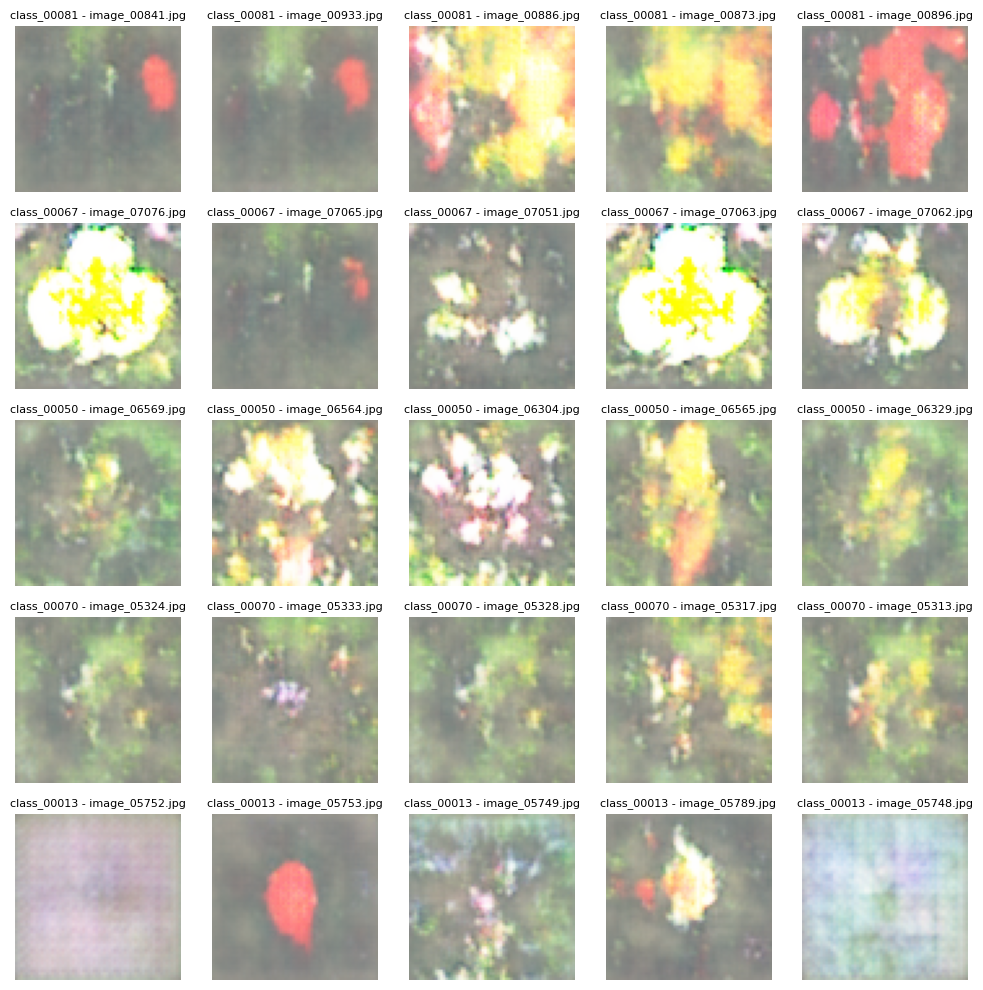

100%|██████████| 484/484 [00:15<00:00, 31.80it/s]


Epoch [81/100] D Loss: -0.3721 G Loss: 0.1795


100%|██████████| 484/484 [00:15<00:00, 31.86it/s]


Epoch [82/100] D Loss: -0.3750 G Loss: 0.1795


100%|██████████| 484/484 [00:15<00:00, 31.91it/s]


Epoch [83/100] D Loss: -0.0546 G Loss: 0.0984


100%|██████████| 484/484 [00:15<00:00, 31.84it/s]


Epoch [84/100] D Loss: -0.3759 G Loss: 0.1796


100%|██████████| 484/484 [00:15<00:00, 31.87it/s]


Epoch [85/100] D Loss: -0.2930 G Loss: -0.1507


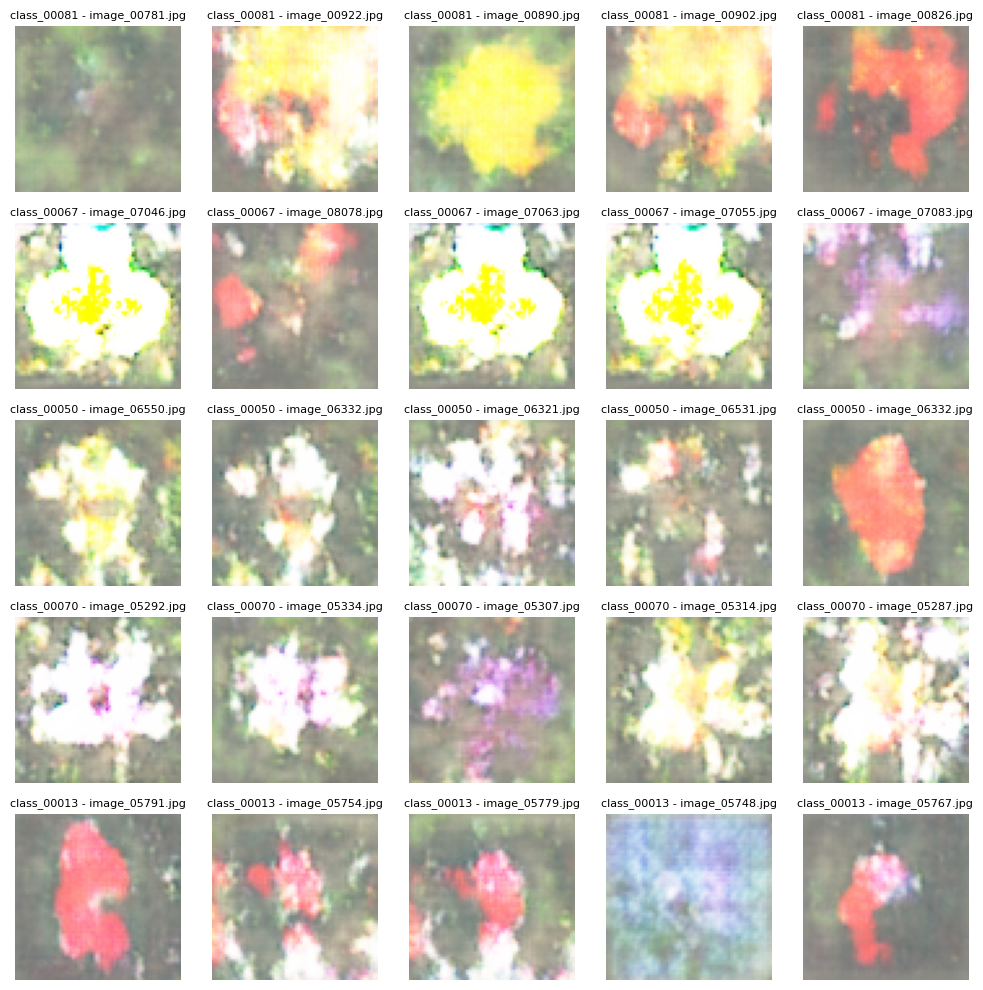

100%|██████████| 484/484 [00:15<00:00, 31.82it/s]


Epoch [86/100] D Loss: -0.3742 G Loss: 0.1792


100%|██████████| 484/484 [00:15<00:00, 31.82it/s]


Epoch [87/100] D Loss: -0.3754 G Loss: 0.1795


100%|██████████| 484/484 [00:15<00:00, 31.76it/s]


Epoch [88/100] D Loss: -0.3741 G Loss: 0.1796


100%|██████████| 484/484 [00:15<00:00, 31.76it/s]


Epoch [89/100] D Loss: -0.3761 G Loss: 0.1795


100%|██████████| 484/484 [00:15<00:00, 32.19it/s]


Epoch [90/100] D Loss: -0.3756 G Loss: 0.1789


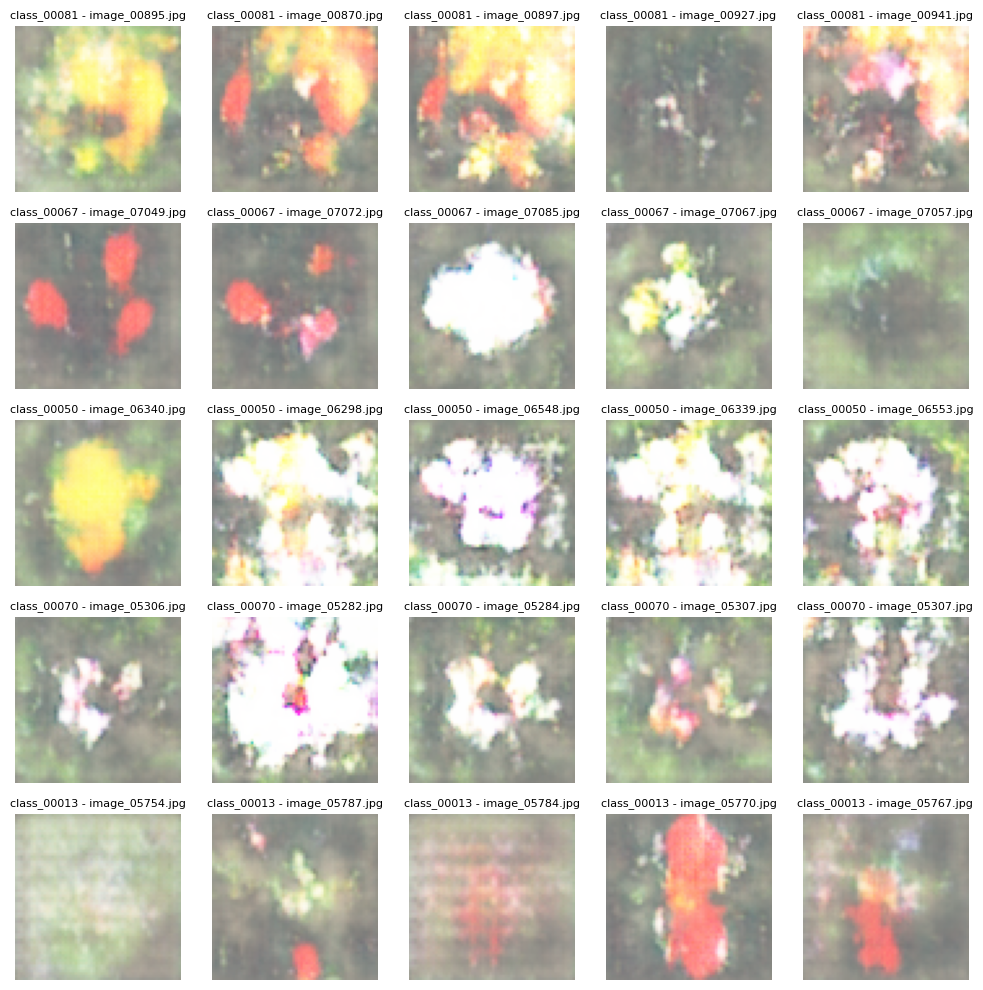

100%|██████████| 484/484 [00:15<00:00, 31.73it/s]


Epoch [91/100] D Loss: -0.3740 G Loss: 0.1786


100%|██████████| 484/484 [00:15<00:00, 31.78it/s]


Epoch [92/100] D Loss: -0.3749 G Loss: 0.1792


100%|██████████| 484/484 [00:15<00:00, 31.94it/s]


Epoch [93/100] D Loss: -0.2357 G Loss: 0.1662


100%|██████████| 484/484 [00:15<00:00, 31.94it/s]


Epoch [94/100] D Loss: -0.3689 G Loss: 0.1774


100%|██████████| 484/484 [00:15<00:00, 31.94it/s]


Epoch [95/100] D Loss: -0.3744 G Loss: 0.1788


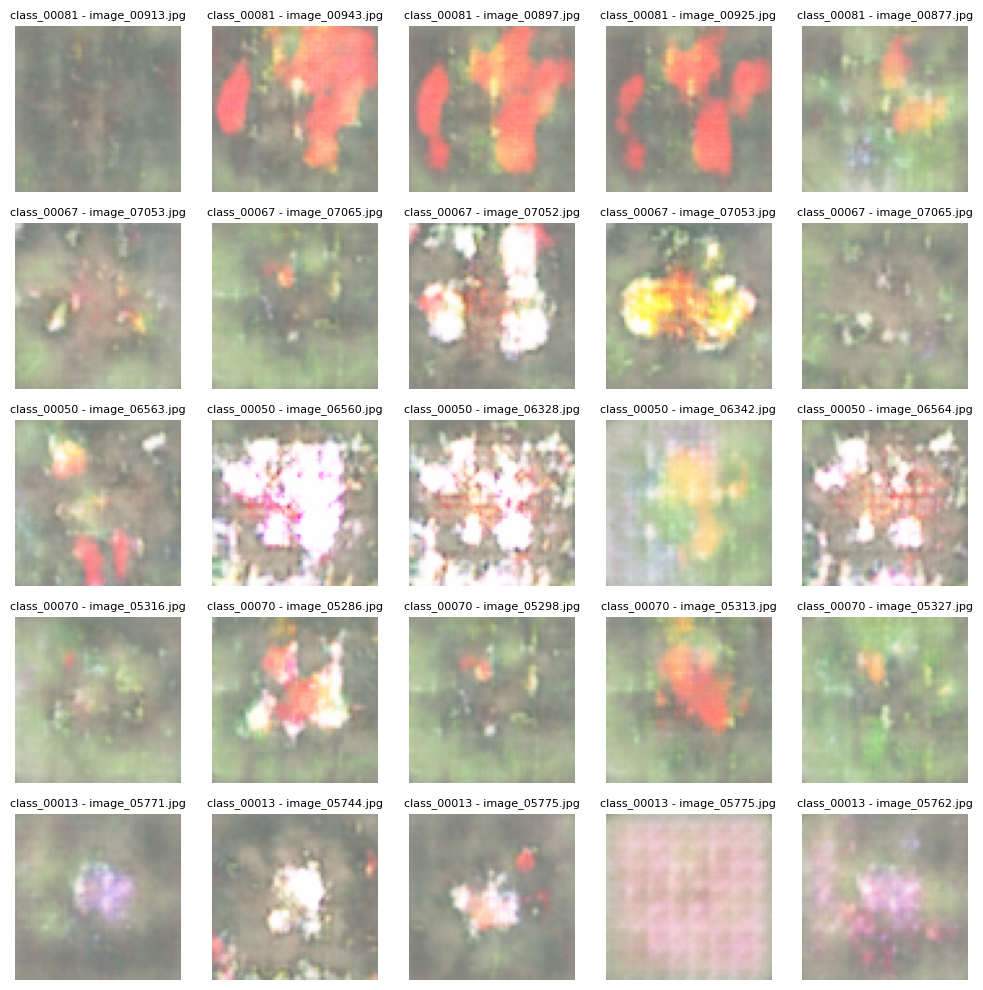

100%|██████████| 484/484 [00:16<00:00, 29.85it/s]


Epoch [96/100] D Loss: -0.3750 G Loss: 0.1788


100%|██████████| 484/484 [00:15<00:00, 31.93it/s]


Epoch [97/100] D Loss: -0.3737 G Loss: 0.1789


100%|██████████| 484/484 [00:15<00:00, 31.73it/s]


Epoch [98/100] D Loss: -0.3753 G Loss: 0.1795


100%|██████████| 484/484 [00:15<00:00, 31.69it/s]

Epoch [99/100] D Loss: -0.3755 G Loss: 0.1798


In [15]:
# Hyperparameters
BATCH_SIZE = 32
LATENT_DIM = 256  # Dimension of the latent space
TEXT_DIM = 1024   # Dimension of text embeddings
LR_G = 1e-4       # Learning rate for the generator
LR_D = 1e-4       # Learning rate for the discriminator
WEIGHT_CLIP = 0.01  # Weight clipping range for WGAN
N_CRITIC = 5      # Number of discriminator updates per generator update
NUM_EPOCHS = 100  # Total number of training epochs
SAVE_EVERY = 5    # Save model checkpoints every 5 epochs

# Create DataLoaders for training and testing
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)

# Move models to device (multi-GPU if available)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
encoder = SourceEncoder(latent_dim=LATENT_DIM).to(device)
generator = Generator(latent_dim=LATENT_DIM, text_dim=TEXT_DIM).to(device)
discriminator = Discriminator().to(device)

# Enable multi-GPU training if available
if torch.cuda.device_count() > 1:
    print(f"Using {torch.cuda.device_count()} GPUs")
    encoder = nn.DataParallel(encoder)
    generator = nn.DataParallel(generator)
    discriminator = nn.DataParallel(discriminator)

# Define WGAN Loss (Wasserstein loss without sigmoid/BCE)
def wgan_discriminator_loss(real_scores, fake_scores):
    """Computes Wasserstein Discriminator loss."""
    return -(torch.mean(real_scores) - torch.mean(fake_scores))

def wgan_generator_loss(fake_scores):
    """Computes Wasserstein Generator loss."""
    return -torch.mean(fake_scores)

# Optimizers using RMSprop (as per WGAN)
optimizer_D = optim.RMSprop(discriminator.parameters(), lr=LR_D)
optimizer_G = optim.RMSprop(generator.parameters(), lr=LR_G)

# Function to clip discriminator weights (important for WGAN)
def clip_discriminator_weights():
    for p in discriminator.parameters():
        p.data.clamp_(-WEIGHT_CLIP, WEIGHT_CLIP)

# Training Loop
for epoch in range(NUM_EPOCHS):

    encoder.train()
    generator.train()

    for i, (real_images, text_embeddings, labels, names) in enumerate(tqdm(train_loader)):
        real_images, text_embeddings = real_images.to(device), text_embeddings.to(device)

        # Generate encoded latent vectors from real images
        latent_vectors = encoder(real_images)

        # Train Discriminator (update N_CRITIC times per generator update)
        for _ in range(N_CRITIC):
            optimizer_D.zero_grad()

            # Generate fake images from latent vectors and text embeddings
            fake_images = generator(latent_vectors.detach(), text_embeddings)

            # Get discriminator predictions for real and fake images
            real_scores = discriminator(real_images)
            fake_scores = discriminator(fake_images.detach())

            # Compute WGAN Discriminator loss
            d_loss = wgan_discriminator_loss(real_scores, fake_scores)

            # Backpropagation and optimization step
            d_loss.backward()
            optimizer_D.step()

            # Apply weight clipping to discriminator parameters (WGAN requirement)
            clip_discriminator_weights()

        # Train Generator
        optimizer_G.zero_grad()

        # Generate fake images again with updated discriminator
        fake_images = generator(latent_vectors, text_embeddings)
        fake_scores = discriminator(fake_images)

        # Compute WGAN Generator loss
        g_loss = wgan_generator_loss(fake_scores)

        # Backpropagation and optimization step
        g_loss.backward()
        optimizer_G.step()

    # Print training loss for current epoch
    print(f"Epoch [{epoch}/{NUM_EPOCHS}] D Loss: {d_loss.item():.4f} G Loss: {g_loss.item():.4f}")

    # Save model checkpoints every few epochs
    # if epoch % SAVE_EVERY == 0:
    #     torch.save(generator.state_dict(), f"generator_epoch_{epoch}.pth")
    #     torch.save(discriminator.state_dict(), f"discriminator_epoch_{epoch}.pth")
    #     torch.save(encoder.state_dict(), f"encoder_epoch_{epoch}.pth")
    #     print(f"Saved models at epoch {epoch}")

    # Generate and visualize 25 test images (5 per test class) every 5 epochs
    if epoch % 5 == 0:
        encoder.eval()
        generator.eval()
        fig, axs = plt.subplots(5, 5, figsize=(10, 10))

        for row, test_class in enumerate(test_classes[:5]):  # Select 5 test classes
            test_label = int(test_class.split('_')[-1])
            class_samples = [test_dataset[i] for i in range(len(test_dataset)) if test_dataset[i][2] == test_label]
            random_samples = random.sample(class_samples, 5)  # Select 5 samples per class

            for col, (image, text_embed, label, name) in enumerate(random_samples):
                image = image.unsqueeze(0).to(device)
                text_embed = text_embed.unsqueeze(0).to(device)

                # Generate image using trained generator
                latent_vector = encoder(image)
                generated_image = generator(latent_vector, text_embed).detach().cpu()

                # Convert tensor to image format and normalize for display
                axs[row, col].imshow((generated_image.squeeze(0).permute(1, 2, 0).numpy() * 0.5) + 0.5)  # Denormalize
                axs[row, col].axis('off')
                axs[row, col].set_title(f"{test_class} - {name}", fontsize=8)

        plt.tight_layout()
        plt.show()
        encoder.train()
        generator.train()


## TESTING SECTION

Showing 25 testing images - done in training section after every 5 epochs

Extracting Features: 100%|██████████| 129/129 [00:00<00:00, 811.71it/s]


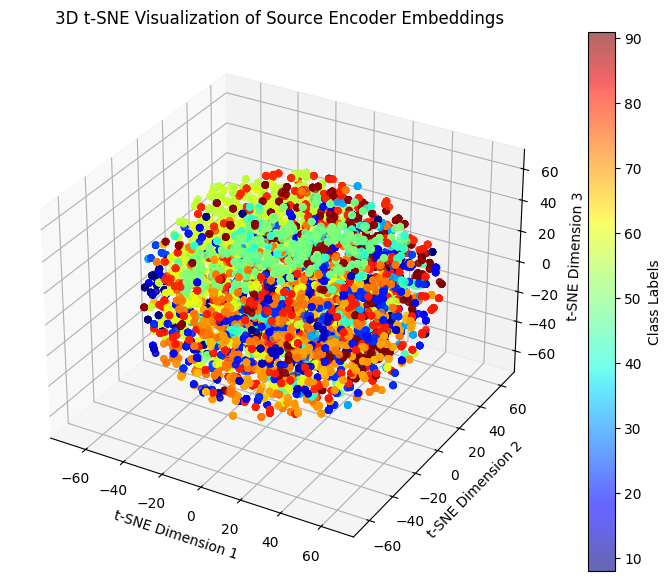

SourceEncoder(
  (encoder): Sequential(
    (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.1)
    (3): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.1)
    (6): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): LeakyReLU(negative_slope=0.1)
    (9): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (10): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): LeakyReLU(negative_slope=0.1)
    (12): Conv2d(256, 512, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (13): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True,

In [ ]:

# Move encoder to evaluation mode
encoder.eval()

# Collect features and labels from both train and test sets
all_features = []
all_labels = []

# Function to extract features from a dataset
def extract_features(dataloader):
    features = []
    labels = []
    with torch.no_grad():  # No gradients needed
        for images, text_embeddings, label, _ in tqdm(dataloader, desc="Extracting Features"):
            images = images.to(device)
            latent_vectors = encoder(images)  # Extract latent vectors from Source Encoder
            features.append(latent_vectors.cpu().numpy())
            labels.append(label.cpu().numpy())

    return np.concatenate(features, axis=0), np.concatenate(labels, axis=0)

# Extract features from train and test sets
train_features, train_labels = extract_features(train_loader)
test_features, test_labels = extract_features(test_loader)

# Combine all features and labels
all_features = np.concatenate([train_features, test_features], axis=0)
all_labels = np.concatenate([train_labels, test_labels], axis=0)

# Apply t-SNE to reduce dimensions to 3D
tsne = TSNE(n_components=3, perplexity=30, random_state=42)
tsne_results = tsne.fit_transform(all_features)

# Plot the 3D t-SNE embedding
fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')

# Scatter plot with color based on labels
scatter = ax.scatter(tsne_results[:, 0], tsne_results[:, 1], tsne_results[:, 2], c=all_labels, cmap='jet', alpha=0.6)

# Add colorbar and labels
plt.colorbar(scatter, label="Class Labels")
ax.set_xlabel("t-SNE Dimension 1")
ax.set_ylabel("t-SNE Dimension 2")
ax.set_zlabel("t-SNE Dimension 3")
ax.set_title("3D t-SNE Visualization of Source Encoder Embeddings")

plt.show()



### **Model Summary Table**

| Model               | Total Parameters | Trainable Parameters | Model Size (MB) |
|---------------------|-----------------|----------------------|-----------------|
| **Source Encoder**  | 4.06M           | 4.06M                | ~17MB           |
| **Target Generator** | 2.03M           | 2.03M                | ~8.5MB          |
| **Discriminator**   | 2.79M           | 2.79M                | ~12.15MB        |

Each model is designed with a balance between **expressiveness and computational efficiency**, ensuring that they meet the assignment constraints while effectively learning representations for **generative text-to-image synthesis**.
